### LLC4320 incoherence timescale estimation

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
from scipy import fft
import seaborn as sns
import pandas as pd

import matplotlib as mpl
mpl.rcParams["font.size"]=15

In [2]:
# definition of root paths
root_dir = '/Users/zcaspar/codes/mit4320/'
fig_dir = '/Users/zcaspar/Documents/Figures_paper2/'

In [3]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature
def plot_maps(ds,colmap='RdBu_r',vlim=(-0.01,0.01),axes=111,lat='lat_bin',**kwargs):
    """
    Plot maps of a given xarray.
    ----------------------------------------------
    Parameters:
    ds : xarray, 2D variable
    colmap : colormap to use in the plot (see list of colormaps on matplotlib), default is 'RdBu_r'
    vlim : tuple, limits of the colorbar (vmin, vmax)
    axes : subplots definition, default is one figure (111)
    lat : str, name of the latitude axis, default is 'lat_bin'
    kwargs : dict, properties of the colorbar (example: {'orientation':'horizontal'})
    """
    crs = ccrs.Robinson()
    #fig = plt.figure(figsize=figsize)
    cbar_kwargs = {'fraction':0.02}
    cbar_kwargs.update(**kwargs)
    ax = fig.add_subplot(axes,projection=crs)
    ds.plot(vmax=vlim[1],vmin=vlim[0],y=lat,ax=ax,
            transform=ccrs.PlateCarree(),cmap=colmap,label=False,#**kwargs,
            cbar_kwargs=cbar_kwargs) #{'fraction':0.02,'label':'energy'}
    ax.gridlines(draw_labels=True)
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.LAND)
    return fig,ax

In [4]:
def ksigma_minimizing(ds,minim=1):
    ds['ksigma'] = ds.k*sigma(ds.tau,ds.Tb,ds.Ub)
    ds['_ksigma'] = ds['ksigma'].fillna(-10)  #fill NaN (avoid crash with argmin function)
    ds['Minimize'] = np.abs(ds['_ksigma']-minim).argmin('tau')  #find tau to minimize k*sigma(tau)-1
    ds['Tapp'] = ds['ksigma'].isel(tau=ds['Minimize']).tau   # Definition of apparent timescale
    ds['Tapp'] = ds['Tapp'].where(np.isnan(ds['ksigma'].isel(tau=0))==False)  # Mask lands
    return ds

In [5]:
#Load incoherence timescales files
dsL =  xr.open_dataset(root_dir+'L_hf_fit_gauss.nc')
dsE =  xr.open_dataset(root_dir+'E_hf_fit_gauss.nc')

ds_low = xr.merge([xr.open_dataset(root_dir+'energy_SSU_low_binned_dl2.0.nc'),    #low frequency energy in 2° bins
                   xr.open_dataset(root_dir+'energy_SSV_low_binned_dl2.0.nc')])  

dsL_low_mean1 = xr.open_dataset(root_dir+'L_low_fit_mean1.nc')  #Lagrangian low frequency variance in 2° bins

In [6]:
def get_tidal_frequencies(*args, units="cpd"):
    """
    """
    from pytide import WaveTable
    td = WaveTable()
    if units=="cpd":
        scale=86400/2/np.pi
    elif units=="cph":
        scale=3600/2/np.pi
    else:
        # cps
        scale=1/2/np.pi
    return {c: td.wave(c).freq * scale for c in args}

tidal_omega = get_tidal_frequencies("M2", "K2","S2","N2")
omega_M2,omega_S2,omega_N2,omega_K2, domega, name = tidal_omega["M2"],tidal_omega["S2"],tidal_omega["N2"],tidal_omega["K2"], .2, "semidiurnal"
omega = (omega_M2+omega_S2)/2

dt = 1/24

omega_sn = (omega_S2-omega_M2)/2
tau = np.arange(0,dsL.lags.max()+dt,dt) #time lag
print('Spring-neap cycle : ', 1/(2*omega_sn), 'days')
print('Oscillation after demodulation ( spring-neap cycle /2): ', 1/omega_sn, 'days')


Spring-neap cycle :  14.765294045749723 days
Oscillation after demodulation ( spring-neap cycle /2):  29.530588091499446 days


### Diagnosed incoherence timescales

Text(0.5, 1.0, '$\\tilde T_L - \\tilde T_E$, SSV')

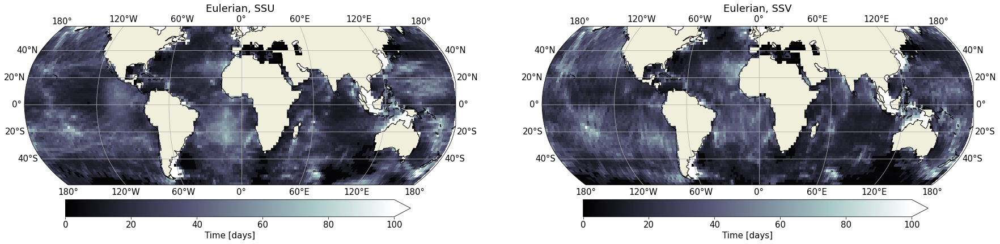

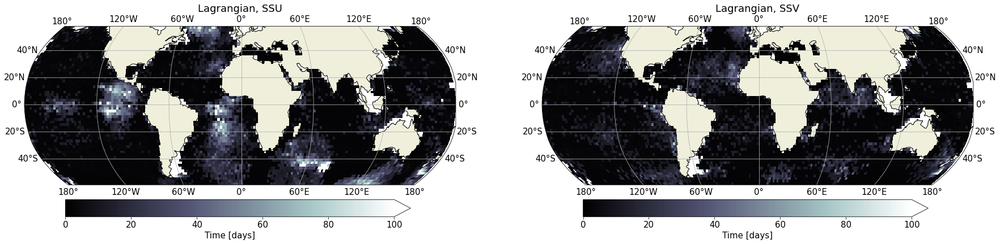

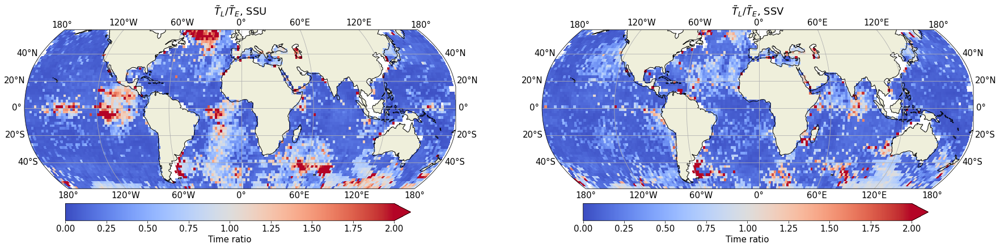

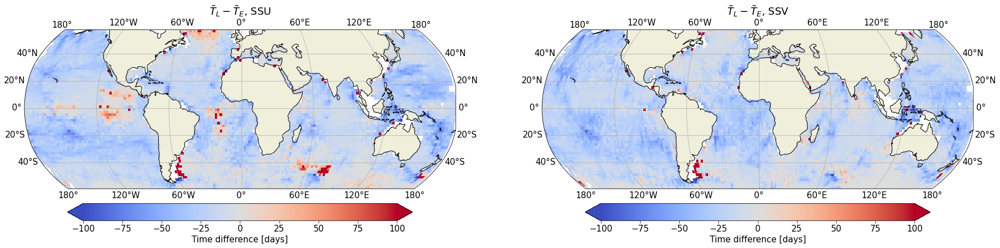

In [7]:
fig = plt.figure(figsize=(30,8))
fig,ax = plot_maps(dsE.sel(param='T').parameters_SSU,colmap='bone',vlim=(0,100),lat='lat_bins',axes=121,
                   **{'orientation':'horizontal','fraction':0.07,'pad':0.06,'label':'Time [days]'})
ax.set_title('Eulerian, SSU')

fig,ax = plot_maps(dsE.sel(param='T').parameters_SSV,colmap='bone',vlim=(0,100),lat='lat_bins',axes=122,
                   **{'orientation':'horizontal','fraction':0.07,'pad':0.06,'label':'Time [days]'})
ax.set_title('Eulerian, SSV')

fig = plt.figure(figsize=(30,8))

fig,ax = plot_maps(dsL.sel(param='T').parameters_SSU,colmap='bone',vlim=(0,100),lat='lat_bins',axes=121,
                   **{'orientation':'horizontal','fraction':0.07,'pad':0.06,'label':'Time [days]'})
ax.set_title('Lagrangian, SSU')
fig,ax = plot_maps(dsL.sel(param='T').parameters_SSV,colmap='bone',vlim=(0,100),lat='lat_bins',axes=122,
                   **{'orientation':'horizontal','fraction':0.07,'pad':0.06,'label':'Time [days]'})
ax.set_title('Lagrangian, SSV')

fig = plt.figure(figsize=(30,8))
fig,ax = plot_maps((dsL/dsE).sel(param='T').parameters_SSU,colmap='coolwarm',vlim=(0,2),lat='lat_bins',axes=121,
                   **{'orientation':'horizontal','fraction':0.07,'pad':0.06,'label':'Time ratio'})
ax.set_title(r'$\tilde T_L / \tilde T_E$, SSU')
fig,ax = plot_maps((dsL/dsE).sel(param='T').parameters_SSV,colmap='coolwarm',vlim=(0,2),lat='lat_bins',axes=122,
                   **{'orientation':'horizontal','fraction':0.07,'pad':0.06,'label':'Time ratio'})
ax.set_title(r'$\tilde T_L / \tilde T_E$, SSV')

fig = plt.figure(figsize=(30,8))
fig,ax = plot_maps((dsL-dsE).sel(param='T').parameters_SSU,colmap='coolwarm',vlim=(-100,100),lat='lat_bins',axes=121,
                   **{'orientation':'horizontal','fraction':0.07,'pad':0.06,'label':'Time difference [days]'})
ax.set_title(r'$\tilde T_L - \tilde T_E$, SSU')
fig,ax = plot_maps((dsL-dsE).sel(param='T').parameters_SSV,colmap='coolwarm',vlim=(-100,100),lat='lat_bins',axes=122,
                   **{'orientation':'horizontal','fraction':0.07,'pad':0.06,'label':'Time difference [days]'})
ax.set_title(r'$\tilde T_L - \tilde T_E$, SSV')

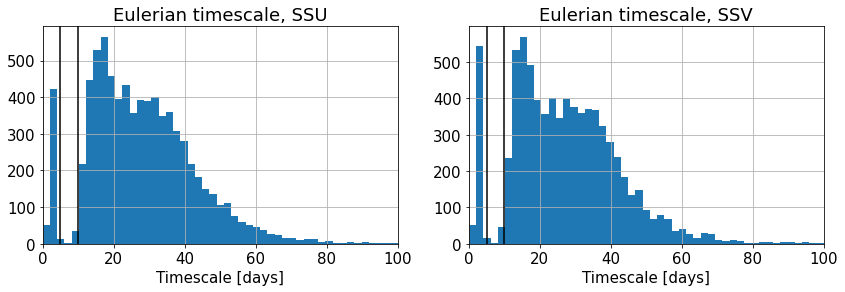

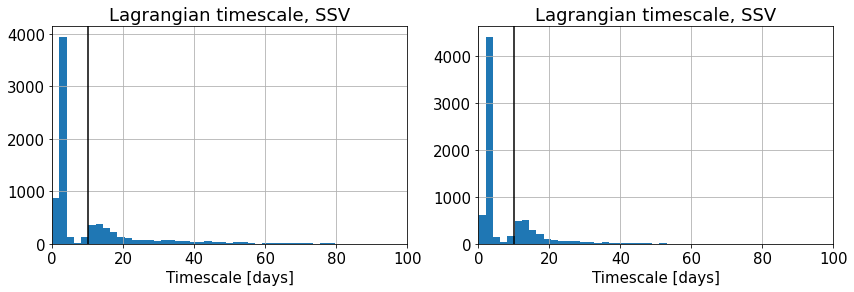

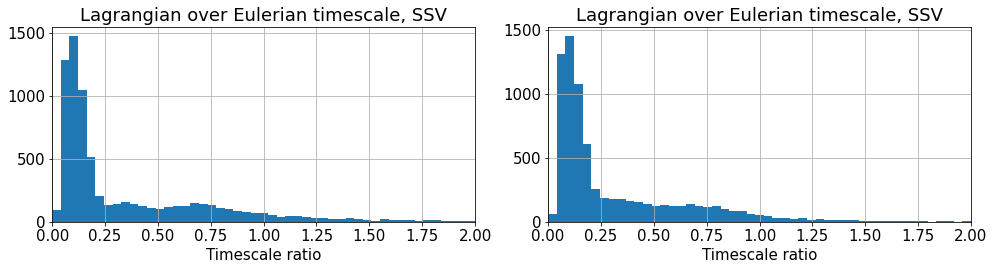

In [8]:
fig,axs = plt.subplots(1,2,figsize=(14,4))
_ = dsE.sel(param='T').parameters_SSU.plot.hist(ax=axs[0],bins=np.linspace(0,100))
_ = dsE.sel(param='T').parameters_SSV.plot.hist(ax=axs[1],bins=np.linspace(0,100))
for V,ax in zip(['U','V'],axs):
    ax.grid();ax.set_xlim(0,100);
    ax.set_title('Eulerian timescale, SS'+V);
    ax.set_xlabel('Timescale [days]');
    ax.axvline(10,c='k');ax.axvline(5,c='k')
    
fig,axs = plt.subplots(1,2,figsize=(14,4))
_ = dsL.sel(param='T').parameters_SSU.plot.hist(ax=axs[0],bins=np.linspace(0,100))
_ = dsL.sel(param='T').parameters_SSV.plot.hist(ax=axs[1],bins=np.linspace(0,100))
for ax in axs:
    ax.grid();ax.set_xlim(0,100);
    ax.set_title('Lagrangian timescale, SS'+V);
    ax.set_xlabel('Timescale [days]');
    ax.axvline(10,c='k')

fig,axs = plt.subplots(1,2,figsize=(14,4))
_ = (dsL/dsE).sel(param='T').parameters_SSU.plot.hist(ax=axs[0],bins=np.linspace(0,2))
_ = (dsL/dsE).sel(param='T').parameters_SSV.plot.hist(ax=axs[1],bins=np.linspace(0,2))
for ax in axs:
    ax.grid();ax.set_xlim(0,2);
    ax.set_title('Lagrangian over Eulerian timescale, SS'+V);
    ax.set_xlabel('Timescale ratio')
fig.tight_layout()
#fig,axs = plt.subplots(1,2,figsize=(12,5))
#_ = dsE.sel(param='T').parameters_SSU.plot.hist(ax=axs[0],bins=np.linspace(0,100))
# = dsE.sel(param='T').parameters_SSV.plot.hist(ax=axs[1],bins=np.linspace(0,100))

/opt/anaconda3/envs/croco/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/anaconda3/envs/croco/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


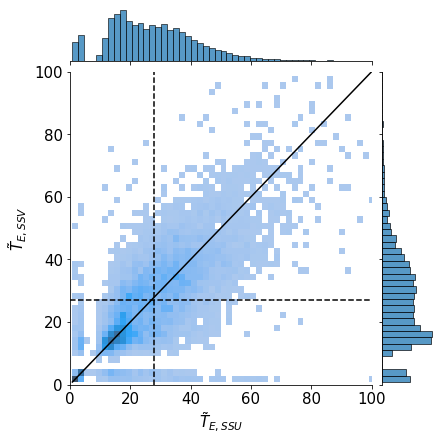

<Figure size 432x288 with 0 Axes>

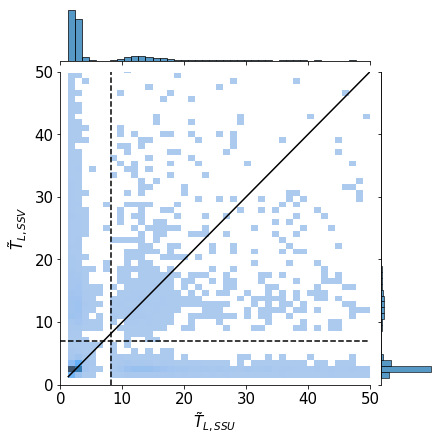

In [21]:
x = dsE.sel(param='T').parameters_SSU.values.flatten()
y = dsE.sel(param='T').parameters_SSV.values.flatten()
axs = sns.jointplot(x,y,xlim=(0,100),ylim=(0,100),kind='hist')
axs.set_axis_labels(r'$\tilde{T}_{E,SSU}$',
                        r'$\tilde{T}_{E,SSV}$');
axs.ax_joint.axvline(axs.x[axs.x<100].mean(), color='k', ls='--', lw=1.5)
#    for ax in (axs.ax_joint, axs.ax_marg_y):
axs.ax_joint.axhline(axs.y[axs.y<100].mean(), color='k', ls='--', lw=1.5);
axs.ax_joint.plot(np.sort(x),np.sort(x),c='k',lw=1.5)

plt.figure()
x = dsL.sel(param='T').parameters_SSU.values.flatten()
y = dsL.sel(param='T').parameters_SSV.values.flatten()
axs = sns.jointplot(x,y,xlim=(0,50),ylim=(0,50),kind='hist')
axs.set_axis_labels(r'$\tilde{T}_{L,SSU}$',
                        r'$\tilde{T}_{L,SSV}$');
axs.ax_joint.axvline(axs.x[axs.x<50].mean(), color='k', ls='--', lw=1.5)
#    for ax in (axs.ax_joint, axs.ax_marg_y):
axs.ax_joint.axhline(axs.y[axs.y<50].mean(), color='k', ls='--', lw=1.5);
axs.ax_joint.plot(np.sort(x),np.sort(x),c='k',lw=1.5)

### Masking small Eulerian timescale: Contamination ratio

In [26]:
#Eulerian
dsE_low_mean0 = xr.open_dataset(root_dir+'E_low_fit_mean0_v2.nc')
dsE_low_mean1 = xr.open_dataset(root_dir+'E_low_fit_mean1.nc')

#Lagrangian
dsL_low_mean0 = xr.open_dataset(root_dir+'L_low_fit_mean0_v2.nc')
dsL_low_mean1 = xr.open_dataset(root_dir+'L_low_fit_mean1.nc')

Te = dsE_low_mean1.sel(param='T').parameters_SSU
Tev = dsE_low_mean1.sel(param='T').parameters_SSV

Tl = dsL_low_mean1.sel(param='T').parameters_SSU
Tlv = dsL_low_mean1.sel(param='T').parameters_SSV

Ue = ds_low.E_energy_SSU
Ve = ds_low.E_energy_SSV

Ul = ds_low.L_energy_SSU
Vl = ds_low.L_energy_SSV

domega = 0.2
_omega = omega

In [27]:
contamination = lambda ds : 4*ds['domega']/(np.pi*(ds['omega']**2)*ds['T'])
contamination_v2 = lambda ds : -2/np.pi*np.arctan(ds['T']*ds['domega']/((ds['T']*ds['domega'])**2-(ds['T']*ds['omega'])**2-1))

In [28]:
dsE_contamination = xr.Dataset({'omega':_omega,'domega':domega,'T':Te})
dsEV_contamination = xr.Dataset({'omega':_omega,'domega':domega,'T':Tev})

dsL_contamination = xr.Dataset({'omega':_omega,'domega':domega,'T':Tl})
dsLV_contamination = xr.Dataset({'omega':_omega,'domega':domega,'T':Tlv})

In [29]:
_dsL_v2 = contamination_v2(dsL_contamination)
_dsLV_v2 = contamination_v2(dsLV_contamination)

_dsE_v2 = contamination_v2(dsE_contamination)
_dsEV_v2 = contamination_v2(dsEV_contamination)

In [32]:
ds_dl2 = xr.merge([xr.open_dataset(root_dir+'energy_SSU_hf_binned_dl2.0.nc'),
                   xr.open_dataset(root_dir+'energy_SSV_hf_binned_dl2.0.nc')])
ds_hf_dl2 = ds_dl2.where(ds_dl2.waterdepth>500)

Text(0.5, 1.0, '$\\tilde V_L^2/E_{cont}(\\overline{V}_L,\\overline{T}_L)$ (2°x2° bins)')

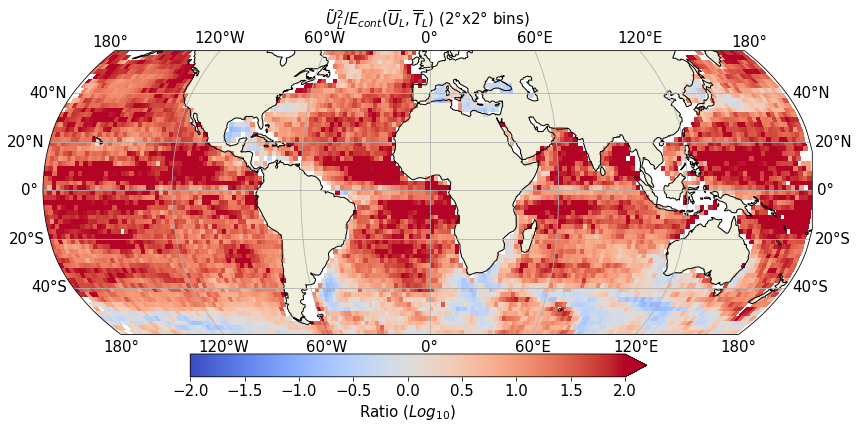

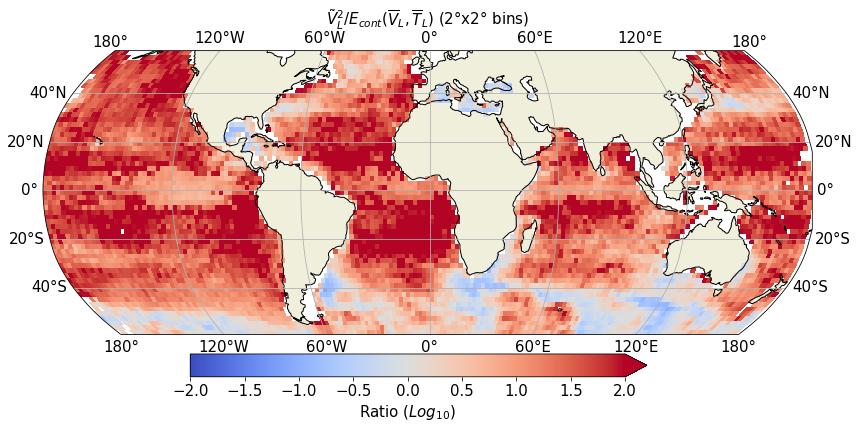

In [55]:
kwargs = {'orientation':'horizontal','fraction':0.07,'pad':0.06,'label':r'Ratio ($Log_{10}$)'}
figsize=(15,6)
fig = plt.figure(figsize=figsize)
fig,ax = plot_maps(np.log10(ds_hf_dl2.L_energy_SSU/(_dsL_v2*Ul)),vlim=(-2,2),colmap='coolwarm',**kwargs)
ax.set_title(r'$\tilde U_L^2/E_{cont}(\overline{U}_L,\overline{T}_L)$ (2°x2° bins)',size=15)

fig = plt.figure(figsize=figsize)
fig,ax = plot_maps(np.log10(ds_hf_dl2.L_energy_SSV/(_dsLV_v2*Vl)),vlim=(-2,2),colmap='coolwarm',**kwargs)
ax.set_title(r'$\tilde V_L^2/E_{cont}(\overline{V}_L,\overline{T}_L)$ (2°x2° bins)',size=15)

Text(0.5, 1.0, '$\\tilde V_E^2/E_{cont}(\\overline{V}_E,\\overline{T}_E)$ (2°x2° bins)')

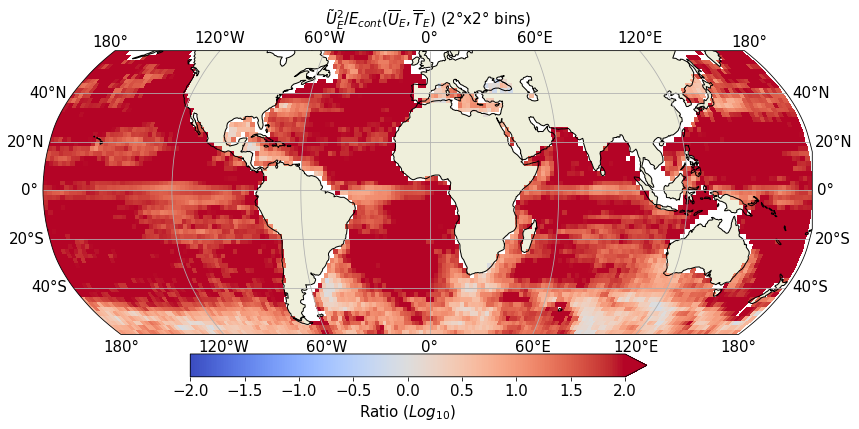

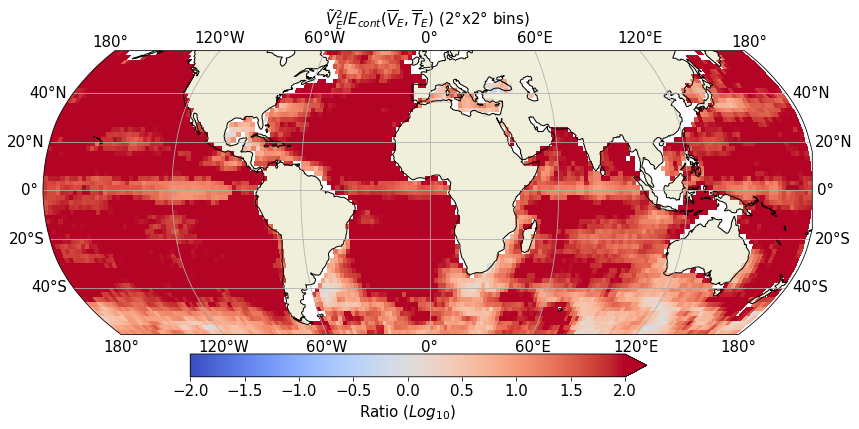

In [53]:
fig = plt.figure(figsize=figsize)
fig,ax = plot_maps(np.log10(ds_hf_dl2.E_energy_SSU/(_dsE_v2*Ue)),vlim=(-2,2),colmap='coolwarm',**kwargs)
ax.set_title(r'$\tilde U_E^2/E_{cont}(\overline{U}_E,\overline{T}_E)$ (2°x2° bins)',size=15)

fig = plt.figure(figsize=figsize)
fig,ax = plot_maps(np.log10(ds_hf_dl2.E_energy_SSV/(_dsEV_v2*Ve)),vlim=(-2,2),colmap='coolwarm',**kwargs)
ax.set_title(r'$\tilde V_E^2/E_{cont}(\overline{V}_E,\overline{T}_E)$ (2°x2° bins)',size=15)

In [54]:
mask_x = ds_hf_dl2.E_energy_SSU/(_dsE_v2*Ue)
mask_x = mask_x.rename({'lon_bin':'lon_bins','lat_bin':'lat_bins'})

mask_y = ds_hf_dl2.E_energy_SSV/(_dsEV_v2*Ve)
mask_y = mask_y.rename({'lon_bin':'lon_bins','lat_bin':'lat_bins'})

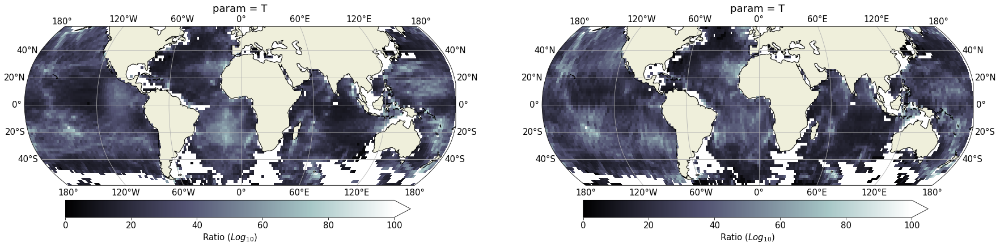

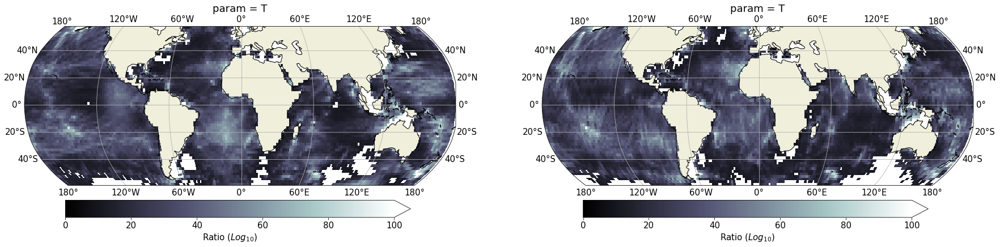

In [65]:
fig = plt.figure(figsize=(30,8))
fig,ax = plot_maps(dsE.sel(param='T').parameters_SSU.where(mask_x>10),axes=121
                   ,vlim=(0,100),lat='lat_bins',colmap='bone',**kwargs)

fig,ax = plot_maps(dsE.sel(param='T').parameters_SSV.where(mask_y>10),axes=122
                   ,vlim=(0,100),lat='lat_bins',colmap='bone',**kwargs)

fig = plt.figure(figsize=(30,8))
fig,ax = plot_maps(dsE.sel(param='T').parameters_SSU.where(dsE.sel(param='T').parameters_SSU>10),axes=121,
                   vlim=(0,100),lat='lat_bins',colmap='bone',**kwargs)

fig,ax = plot_maps(dsE.sel(param='T').parameters_SSV.where(dsE.sel(param='T').parameters_SSV>10),axes=122,
                   vlim=(0,100),lat='lat_bins',colmap='bone',**kwargs)

/opt/anaconda3/envs/croco/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/anaconda3/envs/croco/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/anaconda3/envs/croco/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warn

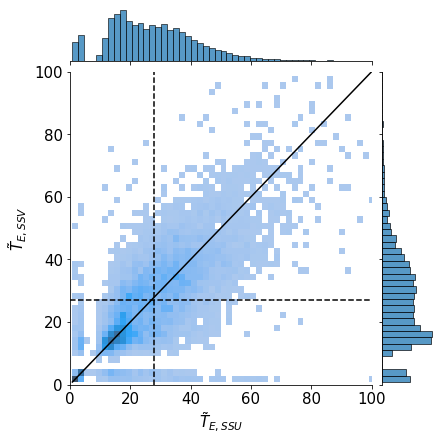

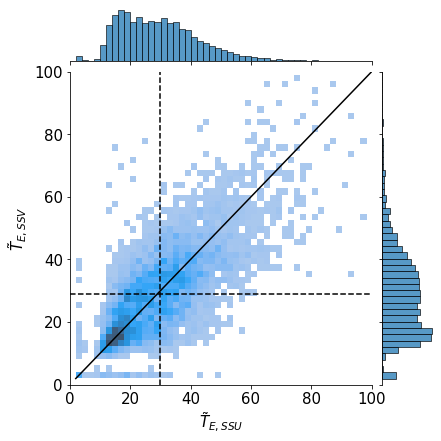

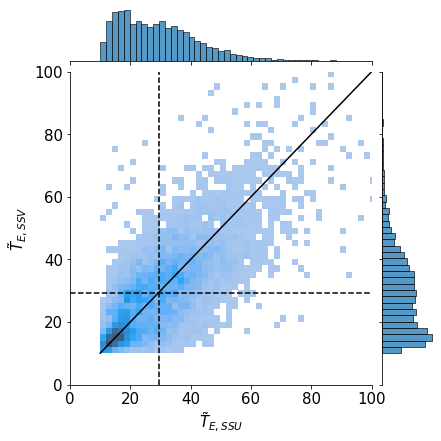

In [66]:
x = dsE.sel(param='T').parameters_SSU.values.flatten()
y = dsE.sel(param='T').parameters_SSV.values.flatten()
axs = sns.jointplot(x,y,xlim=(0,100),ylim=(0,100),kind='hist')
axs.set_axis_labels(r'$\tilde{T}_{E,SSU}$',
                        r'$\tilde{T}_{E,SSV}$');
axs.ax_joint.axvline(axs.x[axs.x<100].mean(), color='k', ls='--', lw=1.5)
#    for ax in (axs.ax_joint, axs.ax_marg_y):
axs.ax_joint.axhline(axs.y[axs.y<100].mean(), color='k', ls='--', lw=1.5);
axs.ax_joint.plot(np.sort(x),np.sort(x),c='k',lw=1.5)

x = dsE.sel(param='T').parameters_SSU.where(mask_x>10).values.flatten()
y = dsE.sel(param='T').parameters_SSV.where(mask_y>10).values.flatten()
axs = sns.jointplot(x,y,xlim=(0,100),ylim=(0,100),kind='hist')
axs.set_axis_labels(r'$\tilde{T}_{E,SSU}$',
                        r'$\tilde{T}_{E,SSV}$');
axs.ax_joint.axvline(axs.x[axs.x<100].mean(), color='k', ls='--', lw=1.5)
#    for ax in (axs.ax_joint, axs.ax_marg_y):
axs.ax_joint.axhline(axs.y[axs.y<100].mean(), color='k', ls='--', lw=1.5);
axs.ax_joint.plot(np.sort(x),np.sort(x),c='k',lw=1.5)

x = dsE.sel(param='T').parameters_SSU.where(dsE.sel(param='T').parameters_SSU>10).values.flatten()
y = dsE.sel(param='T').parameters_SSV.where(dsE.sel(param='T').parameters_SSV>10).values.flatten()
axs = sns.jointplot(x,y,xlim=(0,100),ylim=(0,100),kind='hist')
axs.set_axis_labels(r'$\tilde{T}_{E,SSU}$',
                        r'$\tilde{T}_{E,SSV}$');
axs.ax_joint.axvline(axs.x[axs.x<100].mean(), color='k', ls='--', lw=1.5)
#    for ax in (axs.ax_joint, axs.ax_marg_y):
axs.ax_joint.axhline(axs.y[axs.y<100].mean(), color='k', ls='--', lw=1.5);
axs.ax_joint.plot(np.sort(x),np.sort(x),c='k',lw=1.5)

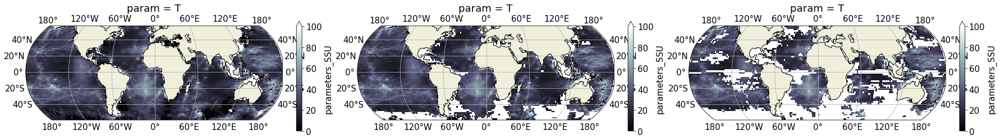

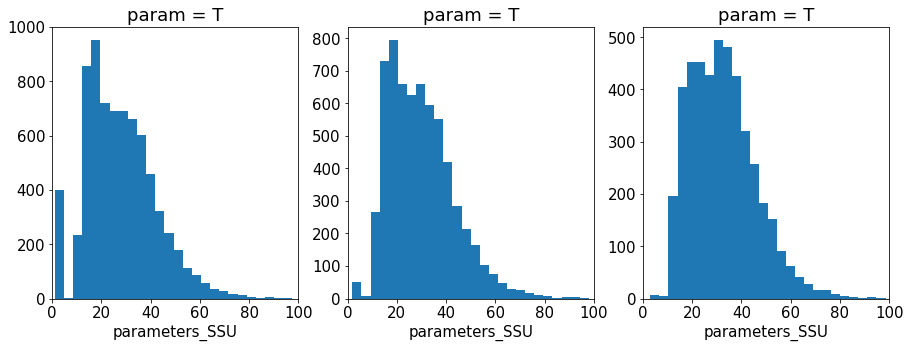

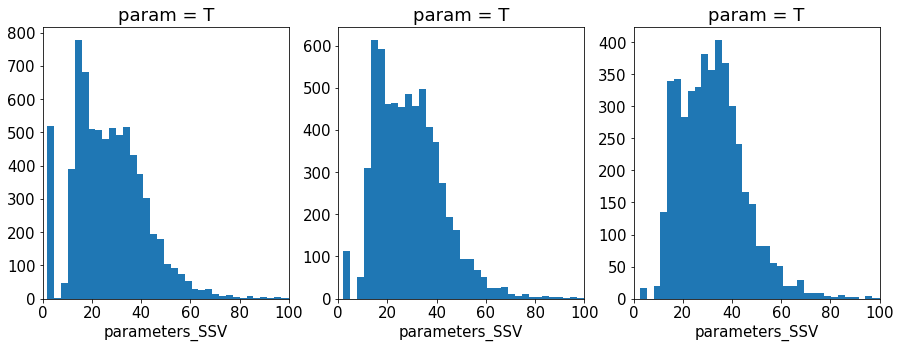

In [75]:
fig = plt.figure(figsize=(30,8))
for ax, mask in zip([131,132,133],[1,10,50]):
    plot_maps(dsE.sel(param='T').parameters_SSU.where(mask_x>mask),vlim=(0,100),colmap='bone',axes=ax,lat='lat_bins')

fig,axs = plt.subplots(1,3,figsize=(15,5))
for ax, mask in zip(axs,[1,10,50]):
    dsE.sel(param='T').parameters_SSU.where(mask_x>mask).plot.hist(ax=ax, bins=50,xlim=(0,100))
    
fig,axs = plt.subplots(1,3,figsize=(15,5))
for ax, mask in zip(axs,[1,10,50]):
    dsE.sel(param='T').parameters_SSV.where(mask_x>mask).plot.hist(ax=ax, bins=50,xlim=(0,100))

/opt/anaconda3/envs/croco/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/anaconda3/envs/croco/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/anaconda3/envs/croco/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warn

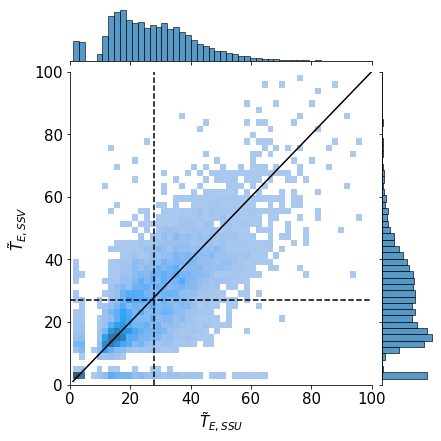

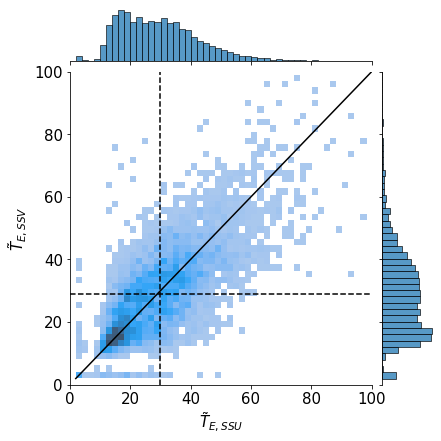

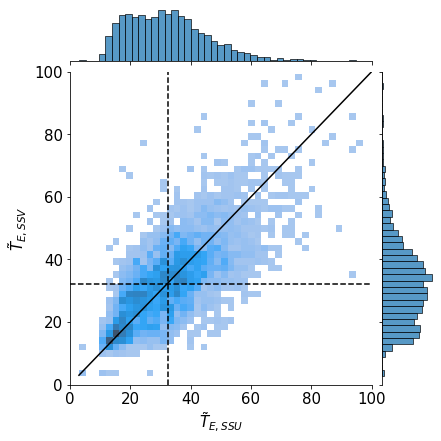

In [76]:
for mask in [1,10,50]:
    x = dsE.sel(param='T').parameters_SSU.where(mask_x>mask).values.flatten()
    y = dsE.sel(param='T').parameters_SSV.where(mask_y>mask).values.flatten()
    axs = sns.jointplot(x,y,xlim=(0,100),ylim=(0,100),kind='hist')
    axs.set_axis_labels(r'$\tilde{T}_{E,SSU}$',
                            r'$\tilde{T}_{E,SSV}$');
    axs.ax_joint.axvline(axs.x[axs.x<100].mean(), color='k', ls='--', lw=1.5)
    #    for ax in (axs.ax_joint, axs.ax_marg_y):
    axs.ax_joint.axhline(axs.y[axs.y<100].mean(), color='k', ls='--', lw=1.5);
    axs.ax_joint.plot(np.sort(x),np.sort(x),c='k',lw=1.5)

/opt/anaconda3/envs/croco/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/anaconda3/envs/croco/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/opt/anaconda3/envs/croco/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warn

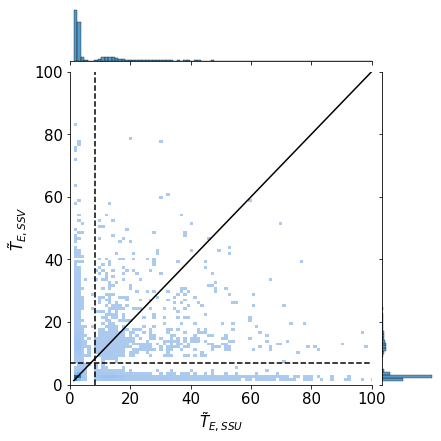

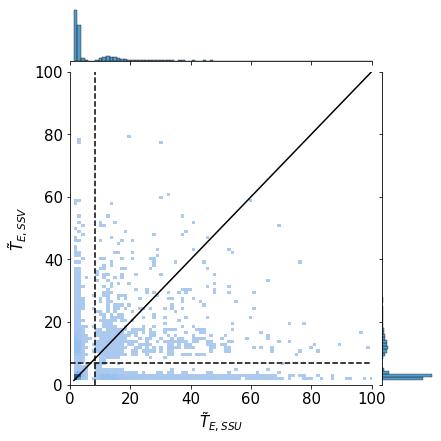

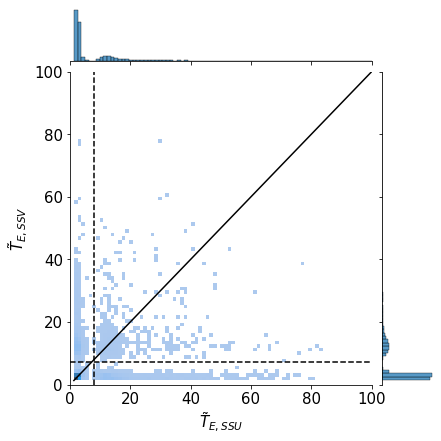

In [77]:
for mask in [1,10,50]:
    x = dsL.sel(param='T').parameters_SSU.where(mask_x>mask).values.flatten()
    y = dsL.sel(param='T').parameters_SSV.where(mask_y>mask).values.flatten()
    axs = sns.jointplot(x,y,xlim=(0,100),ylim=(0,100),kind='hist')
    axs.set_axis_labels(r'$\tilde{T}_{E,SSU}$',
                            r'$\tilde{T}_{E,SSV}$');
    axs.ax_joint.axvline(axs.x[axs.x<50].mean(), color='k', ls='--', lw=1.5)
    #    for ax in (axs.ax_joint, axs.ax_marg_y):
    axs.ax_joint.axhline(axs.y[axs.y<50].mean(), color='k', ls='--', lw=1.5);
    axs.ax_joint.plot(np.sort(x),np.sort(x),c='k',lw=1.5)

#### Pourquoi les valeurs estimées ne sont jamais autour de 10 jours dans les deux perspectives??

In [6]:
# Load autocovariance files
file_E = root_dir +'binned_Ecov_uu_dl2.nc'
file_L = root_dir +'binned_Lcov_uu_dl2_flag10.nc'

dsE_cov = xr.open_dataset(file_E)
dsL_cov = xr.open_dataset(file_L)

dsEV_cov = xr.open_dataset(root_dir +'binned_Ecov_vv_dl2.nc')
dsLV_cov = xr.open_dataset(root_dir +'binned_Lcov_vv_dl2_flag10.nc')

In [7]:
Evar_test = dsE.sel(param='T').parameters_SSU
Lvar_test = dsL.sel(param='T').parameters_SSU

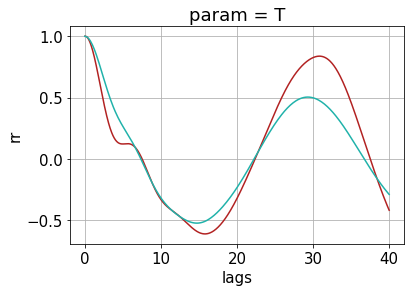

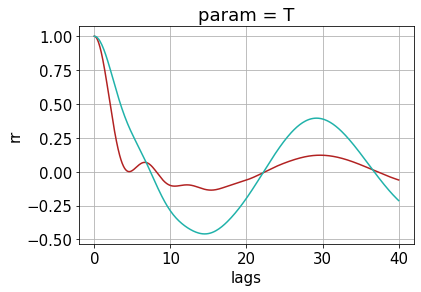

In [20]:
(dsL_cov/dsL_cov.isel(lags=0)).where(Lvar_test>80).rr.mean(['lon_bins','lat_bins']).plot(c='firebrick')
(dsE_cov/dsE_cov.isel(lags=0)).where(Lvar_test>80).rr.mean(['lon_bins','lat_bins']).plot(c='lightseagreen')
plt.grid()

plt.figure()
(dsL_cov/dsL_cov.isel(lags=0)).where(Lvar_test<80).rr.mean(['lon_bins','lat_bins']).plot(c='firebrick')
(dsE_cov/dsE_cov.isel(lags=0)).where(Lvar_test<80).rr.mean(['lon_bins','lat_bins']).plot(c='lightseagreen')
plt.grid();

In [24]:
_ = pd.read_parquet(root_dir+'Lagrangian_datamean_149W1N')

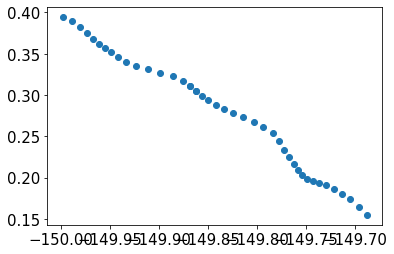

In [26]:
plt.scatter(_[_.trajectory==_.trajectory.values[0]].lon,_[_.trajectory==_.trajectory.values[0]].lat)


<AxesSubplot:xlabel='time'>

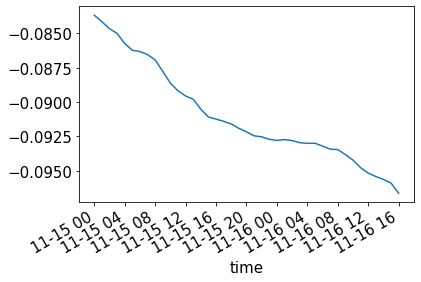

In [31]:
_[_.trajectory==_.trajectory.values[0]].mean_zonal_velocity.plot()

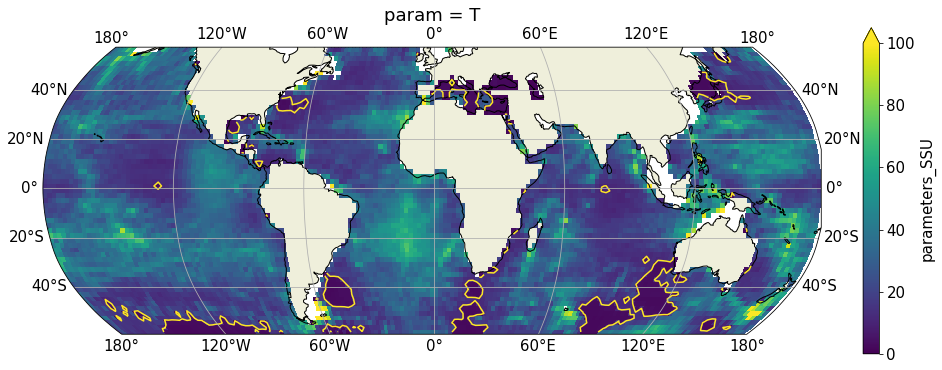

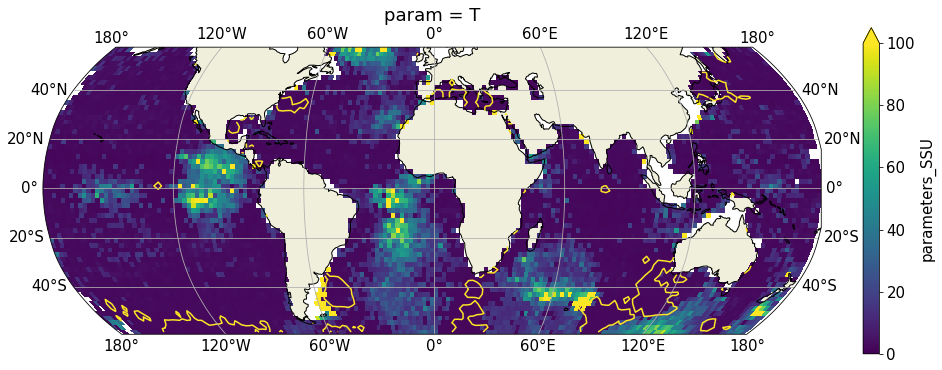

In [19]:
fig = plt.figure(figsize=(15,6))
fig,axs = plot_maps(Evar_test,colmap='viridis',lat='lat_bins',vlim=(0,100))
Evar_test.plot.contour(ax=axs,levels=[10],y='lat_bins',transform=ccrs.PlateCarree())
#axs.set_ylim(-60,60)

fig = plt.figure(figsize=(15,6))
fig,axs = plot_maps(Lvar_test,colmap='viridis',lat='lat_bins',vlim=(0,100))
Evar_test.plot.contour(ax=axs,levels=[10],y='lat_bins',transform=ccrs.PlateCarree())

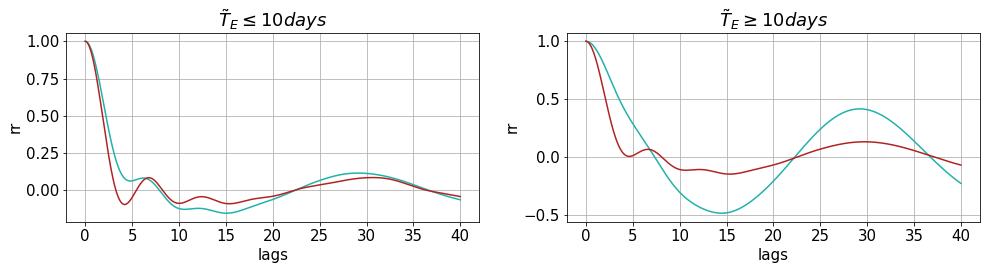

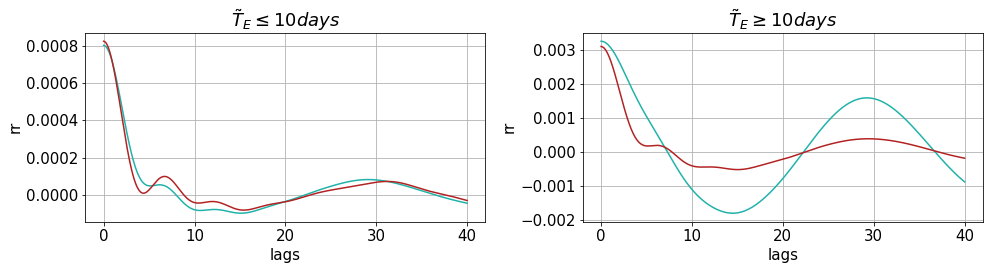

In [37]:
fig,ax = plt.subplots(1,2,figsize=(14,4))
(dsE_cov/dsE_cov.isel(lags=0)).where((Evar_test<=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='lightseagreen')
(dsL_cov/dsL_cov.isel(lags=0)).where((Evar_test<=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick')

(dsE_cov/dsE_cov.isel(lags=0)).where((Evar_test>=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen')
(dsL_cov/dsL_cov.isel(lags=0)).where((Evar_test>=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='firebrick')
ax[0].set_title(r'$\tilde T_E\leq 10days$')
ax[1].set_title(r'$\tilde T_E\geq 10days$')
for a in ax:
    a.grid();
fig.tight_layout()

fig,ax = plt.subplots(1,2,figsize=(14,4))
dsE_cov.where((Evar_test<=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='lightseagreen')
dsL_cov.where((Evar_test<=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick')

dsE_cov.where((Evar_test>=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen')
dsL_cov.where((Evar_test>=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='firebrick')
ax[0].set_title(r'$\tilde T_E\leq 10days$')
ax[1].set_title(r'$\tilde T_E\geq 10days$')
for a in ax:
    a.grid();
fig.tight_layout()

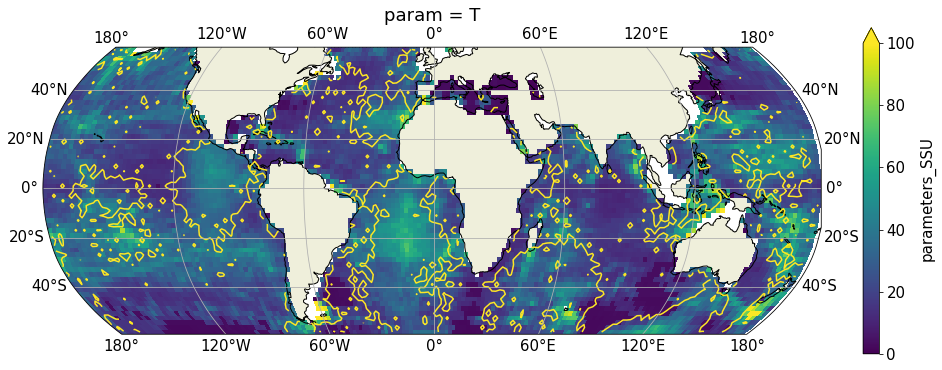

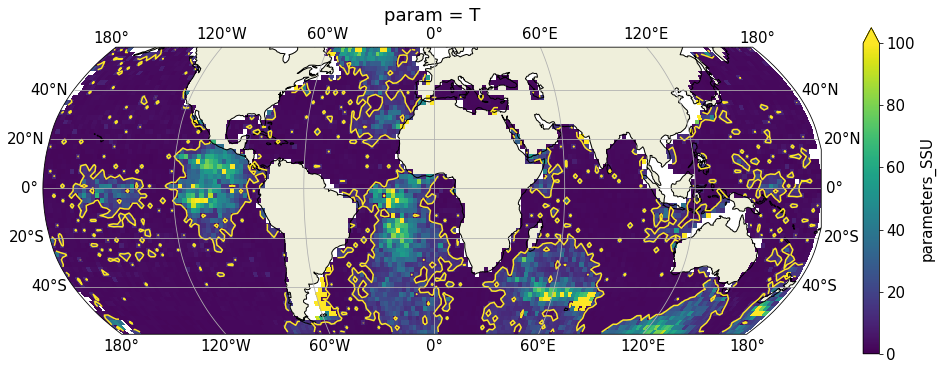

In [21]:
fig = plt.figure(figsize=(15,6))
fig,axs = plot_maps(Evar_test,colmap='viridis',lat='lat_bins',vlim=(0,100))
Lvar_test.plot.contour(ax=axs,levels=[10],y='lat_bins',transform=ccrs.PlateCarree())
#axs.set_ylim(-60,60)

fig = plt.figure(figsize=(15,6))
fig,axs = plot_maps(Lvar_test,colmap='viridis',lat='lat_bins',vlim=(0,100))
Lvar_test.plot.contour(ax=axs,levels=[10],y='lat_bins',transform=ccrs.PlateCarree())

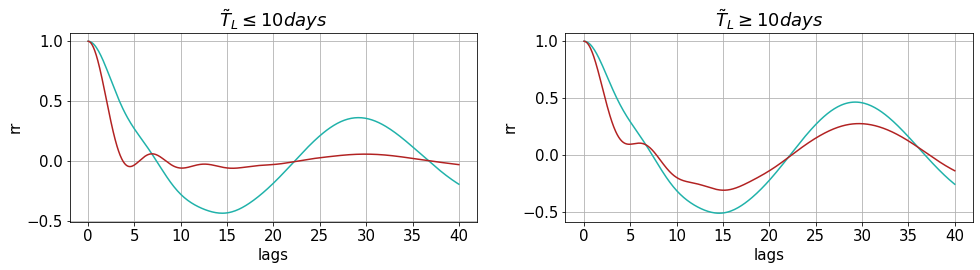

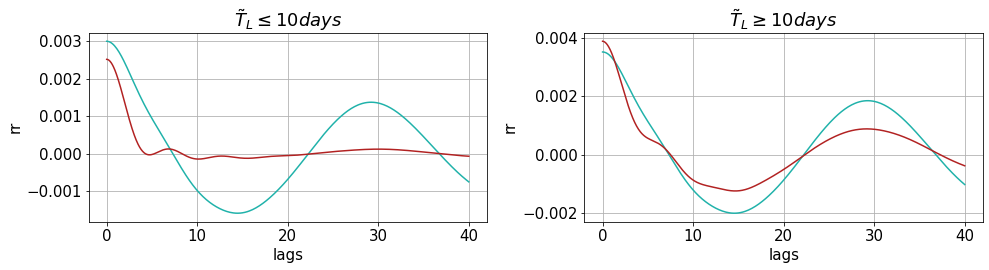

In [36]:
fig,ax = plt.subplots(1,2,figsize=(14,4))
(dsE_cov/dsE_cov.isel(lags=0)).where((Lvar_test<=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='lightseagreen')
(dsL_cov/dsL_cov.isel(lags=0)).where((Lvar_test<=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick')

(dsE_cov/dsE_cov.isel(lags=0)).where((Lvar_test>=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen')
(dsL_cov/dsL_cov.isel(lags=0)).where((Lvar_test>=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='firebrick')
ax[0].set_title(r'$\tilde T_L\leq 10days$')
ax[1].set_title(r'$\tilde T_L\geq 10days$')
for a in ax:
    a.grid();
fig.tight_layout()

fig,ax = plt.subplots(1,2,figsize=(14,4))
(dsE_cov).where((Lvar_test<=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='lightseagreen')
(dsL_cov).where((Lvar_test<=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick')

(dsE_cov).where((Lvar_test>=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen')
(dsL_cov).where((Lvar_test>=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='firebrick')
ax[0].set_title(r'$\tilde T_L\leq 10days$')
ax[1].set_title(r'$\tilde T_L\geq 10days$')
for a in ax:
    a.grid();
fig.tight_layout()

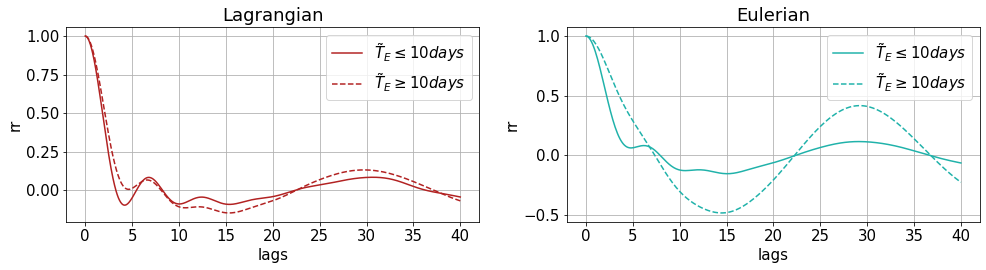

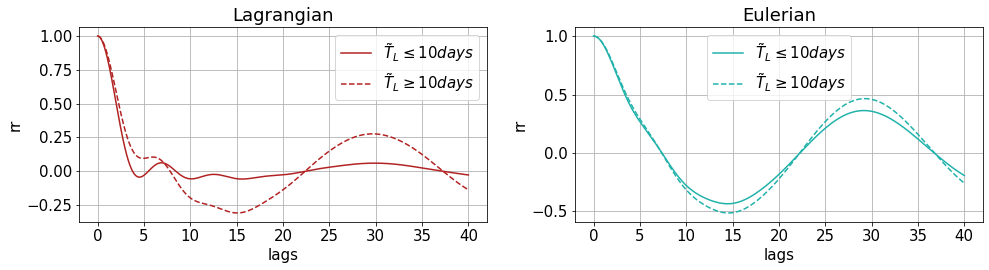

In [39]:
fig,ax = plt.subplots(1,2,figsize=(14,4))
(dsL_cov/dsL_cov.isel(lags=0)).where((Evar_test<=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick',
                                                                     label=r'$\tilde T_E\leq 10 days$')
(dsL_cov/dsL_cov.isel(lags=0)).where((Evar_test>=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick',ls='--',
                                                                    label=r'$\tilde T_E\geq 10 days$')

(dsE_cov/dsE_cov.isel(lags=0)).where((Evar_test<=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen',
                                                                     label=r'$\tilde T_E\leq 10 days$')
(dsE_cov/dsE_cov.isel(lags=0)).where((Evar_test>=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen',ls='--',
                                                                    label=r'$\tilde T_E\geq 10 days$')

#dsE_cov.where((Evar_test>=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen')
#sL_cov.where((Evar_test>=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='firebrick')
ax[0].set_title('Lagrangian')
ax[1].set_title('Eulerian')
for a in ax:
    a.grid();a.legend()
fig.tight_layout()


fig,ax = plt.subplots(1,2,figsize=(14,4))
(dsL_cov/dsL_cov.isel(lags=0)).where((Lvar_test<=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick',
                                                                     label=r'$\tilde T_L\leq 10 days$')
(dsL_cov/dsL_cov.isel(lags=0)).where((Lvar_test>=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick',ls='--',
                                                                    label=r'$\tilde T_L\geq 10 days$')

(dsE_cov/dsE_cov.isel(lags=0)).where((Lvar_test<=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen',
                                                                     label=r'$\tilde T_L\leq 10 days$')
(dsE_cov/dsE_cov.isel(lags=0)).where((Lvar_test>=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen',ls='--',
                                                                    label=r'$\tilde T_L\geq 10 days$')

#dsE_cov.where((Evar_test>=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen')
#sL_cov.where((Evar_test>=10)).rr.mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='firebrick')
ax[0].set_title('Lagrangian')
ax[1].set_title('Eulerian')
for a in ax:
    a.grid();a.legend()
fig.tight_layout()

In [24]:
dsE_SSUV = xr.open_dataset(root_dir+'E_SSUV.nc')
dsL_SSUV = xr.open_dataset(root_dir+'L_SSUV.nc')

In [26]:
ESSUV_T60 = dsE_SSUV.SSUV_T60.groupby_bins('lat_bins',bins=np.arange(-60,60,2)
                                 ).mean().groupby_bins('lon_bins',bins=np.arange(-180,180,2)).mean()
ESSUV_T60 = ESSUV_T60.rename({'lat_bins_bins':'lat_bins','lon_bins_bins':'lon_bins'})
ESSUV_T60 = ESSUV_T60.assign_coords({'lat_bins':Evar_test.lat_bins,'lon_bins':Evar_test.lon_bins})

In [27]:
LSSUV_T60 = dsL_SSUV.SSUV_T60.groupby_bins('lat_bins',bins=np.arange(-60,60,2)
                                 ).mean().groupby_bins('lon_bins',bins=np.arange(-180,180,2)).mean()
LSSUV_T60 = LSSUV_T60.rename({'lat_bins_bins':'lat_bins','lon_bins_bins':'lon_bins'})
LSSUV_T60 = LSSUV_T60.assign_coords({'lat_bins':Lvar_test.lat_bins,'lon_bins':Lvar_test.lon_bins})

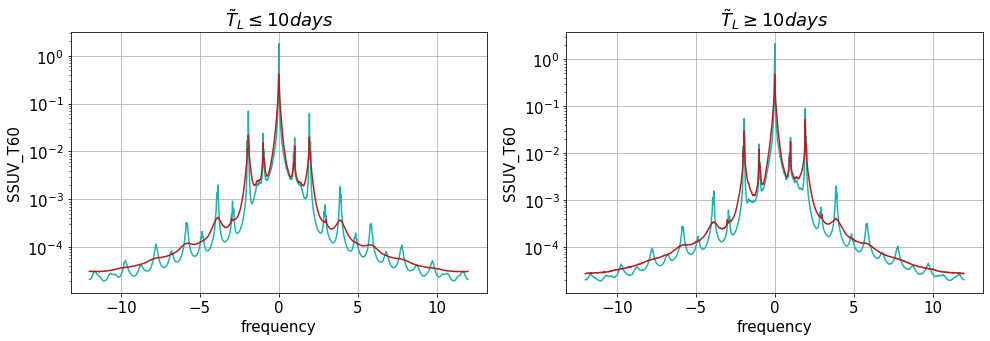

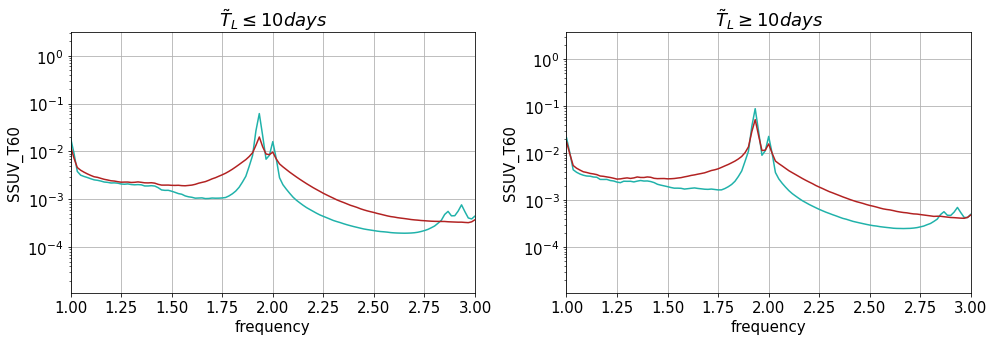

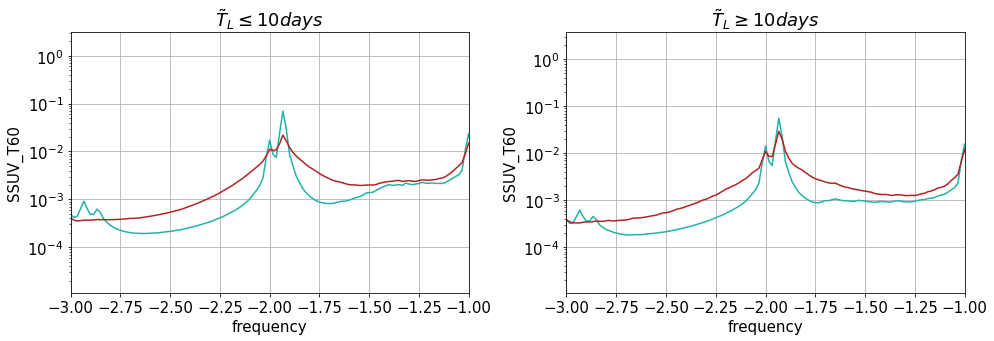

In [30]:
fig,ax = plt.subplots(1,2,figsize=(14,5))
ESSUV_T60.where((Lvar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='lightseagreen')
LSSUV_T60.where((Lvar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick')

ESSUV_T60.where((Lvar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen')
LSSUV_T60.where((Lvar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='firebrick')
ax[0].set_title(r'$\tilde T_L\leq 10days$')
ax[1].set_title(r'$\tilde T_L\geq 10days$')
for a in ax:
    a.grid();a.set_yscale('log')
fig.tight_layout()

fig,ax = plt.subplots(1,2,figsize=(14,5))
ESSUV_T60.where((Lvar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='lightseagreen')
LSSUV_T60.where((Lvar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick')

ESSUV_T60.where((Lvar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen')
LSSUV_T60.where((Lvar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='firebrick')

ax[0].set_title(r'$\tilde T_L\leq 10days$')
ax[1].set_title(r'$\tilde T_L\geq 10days$')
for a in ax:
    a.grid();a.set_yscale('log');
    a.set_xlim(1.,3)
fig.tight_layout()

fig,ax = plt.subplots(1,2,figsize=(14,5))
ESSUV_T60.where((Lvar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='lightseagreen')
LSSUV_T60.where((Lvar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick')

ESSUV_T60.where((Lvar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen')
LSSUV_T60.where((Lvar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='firebrick')

ax[0].set_title(r'$\tilde T_L\leq 10days$')
ax[1].set_title(r'$\tilde T_L\geq 10days$')
for a in ax:
    a.grid();a.set_yscale('log');
    a.set_xlim(-3.,-1)
fig.tight_layout()

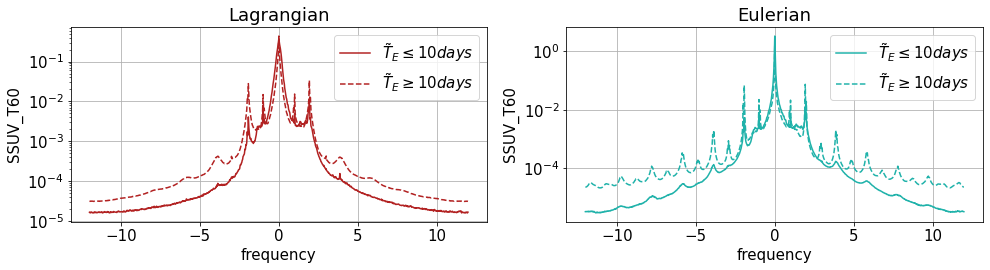

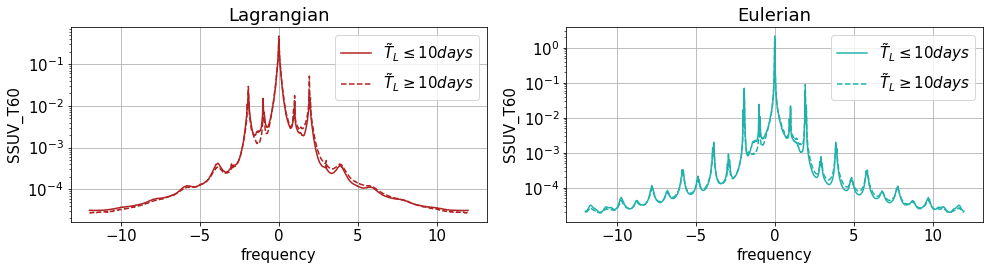

In [31]:
fig,ax = plt.subplots(1,2,figsize=(14,4))
LSSUV_T60.where((Evar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick',
                                                                     label=r'$\tilde T_E\leq 10 days$')
LSSUV_T60.where((Evar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick',ls='--',
                                                                    label=r'$\tilde T_E\geq 10 days$')

ESSUV_T60.where((Evar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen',
                                                                     label=r'$\tilde T_E\leq 10 days$')
ESSUV_T60.where((Evar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen',ls='--',
                                                                    label=r'$\tilde T_E\geq 10 days$')

ax[0].set_title(r'Lagrangian')
ax[1].set_title(r'Eulerian')
for a in ax:
    a.grid();a.legend();a.set_yscale('log')
fig.tight_layout()

fig,ax = plt.subplots(1,2,figsize=(14,4))
LSSUV_T60.where((Lvar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick',
                                                                     label=r'$\tilde T_L\leq 10 days$')
LSSUV_T60.where((Lvar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick',ls='--',
                                                                    label=r'$\tilde T_L\geq 10 days$')

ESSUV_T60.where((Lvar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen',
                                                                     label=r'$\tilde T_L\leq 10 days$')
ESSUV_T60.where((Lvar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen',ls='--',
                                                                    label=r'$\tilde T_L\geq 10 days$')

ax[0].set_title(r'Lagrangian')
ax[1].set_title(r'Eulerian')
for a in ax:
    a.grid();a.legend();a.set_yscale('log')
fig.tight_layout()

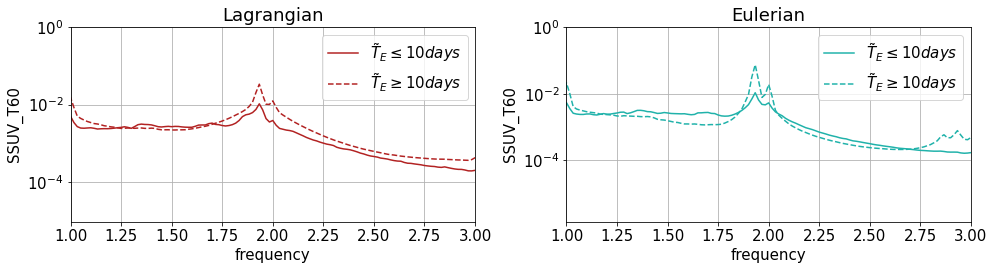

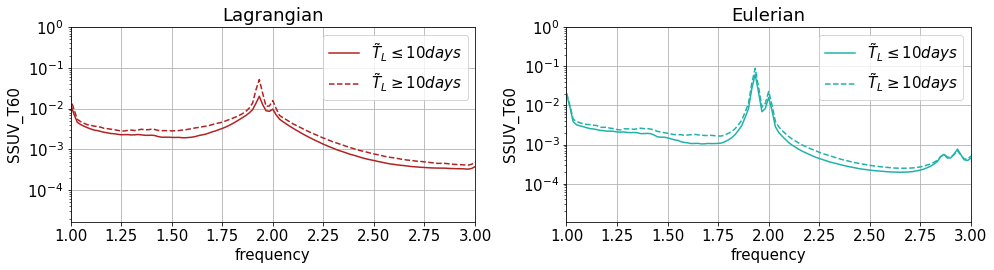

In [32]:
fig,ax = plt.subplots(1,2,figsize=(14,4))
LSSUV_T60.where((Evar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick',
                                                                     label=r'$\tilde T_E\leq 10 days$')
LSSUV_T60.where((Evar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick',ls='--',
                                                                    label=r'$\tilde T_E\geq 10 days$')

ESSUV_T60.where((Evar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen',
                                                                     label=r'$\tilde T_E\leq 10 days$')
ESSUV_T60.where((Evar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen',ls='--',
                                                                    label=r'$\tilde T_E\geq 10 days$')

ax[0].set_title(r'Lagrangian')
ax[1].set_title(r'Eulerian')
for a in ax:
    a.grid();a.legend();a.set_yscale('log');
    a.set_ylim(None,1);a.set_xlim(1,3)
fig.tight_layout()

fig,ax = plt.subplots(1,2,figsize=(14,4))
LSSUV_T60.where((Lvar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick',
                                                                     label=r'$\tilde T_L\leq 10 days$')
LSSUV_T60.where((Lvar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick',ls='--',
                                                                    label=r'$\tilde T_L\geq 10 days$')

ESSUV_T60.where((Lvar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen',
                                                                     label=r'$\tilde T_L\leq 10 days$')
ESSUV_T60.where((Lvar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen',ls='--',
                                                                    label=r'$\tilde T_L\geq 10 days$')

ax[0].set_title(r'Lagrangian')
ax[1].set_title(r'Eulerian')
for a in ax:
    a.grid();a.legend();a.set_yscale('log');
    a.set_ylim(None,1);a.set_xlim(1,3)
fig.tight_layout()

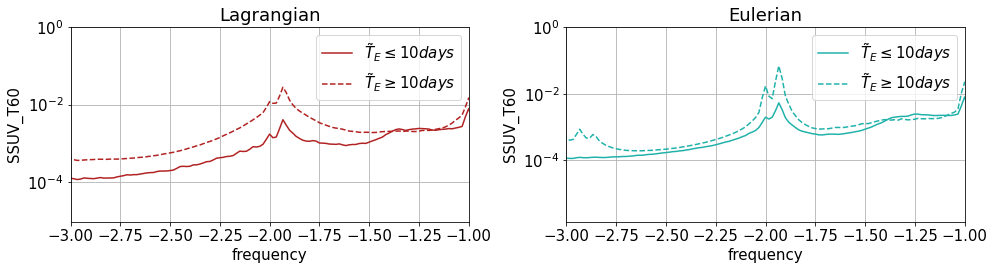

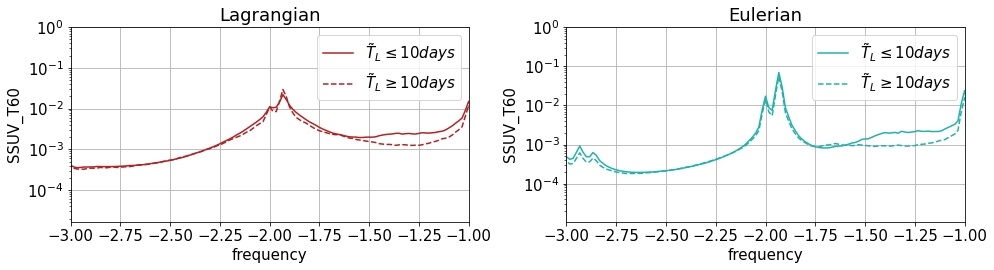

In [213]:
fig,ax = plt.subplots(1,2,figsize=(14,4))
LSSUV_T60.where((Evar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick',
                                                                     label=r'$\tilde T_E\leq 10 days$')
LSSUV_T60.where((Evar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick',ls='--',
                                                                    label=r'$\tilde T_E\geq 10 days$')

ESSUV_T60.where((Evar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen',
                                                                     label=r'$\tilde T_E\leq 10 days$')
ESSUV_T60.where((Evar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen',ls='--',
                                                                    label=r'$\tilde T_E\geq 10 days$')

ax[0].set_title(r'Lagrangian')
ax[1].set_title(r'Eulerian')
for a in ax:
    a.grid();a.legend();a.set_yscale('log');
    a.set_ylim(None,1);a.set_xlim(-3,-1)
fig.tight_layout()

fig,ax = plt.subplots(1,2,figsize=(14,4))
LSSUV_T60.where((Lvar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick',
                                                                     label=r'$\tilde T_L\leq 10 days$')
LSSUV_T60.where((Lvar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[0],c='firebrick',ls='--',
                                                                    label=r'$\tilde T_L\geq 10 days$')

ESSUV_T60.where((Lvar_test<=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen',
                                                                     label=r'$\tilde T_L\leq 10 days$')
ESSUV_T60.where((Lvar_test>=10)).mean(['lon_bins','lat_bins']).plot(ax=ax[1],c='lightseagreen',ls='--',
                                                                    label=r'$\tilde T_L\geq 10 days$')

ax[0].set_title(r'Lagrangian')
ax[1].set_title(r'Eulerian')
for a in ax:
    a.grid();a.legend();a.set_yscale('log');
    a.set_ylim(None,1);a.set_xlim(-3,-1)
fig.tight_layout()

### Apparent incoherence timescale

We define an appparent incoherence timescale as
$\tau$ such as $k^2\sigma^2(\tau)/2=1$

=> $k\sigma(\tau)=\sqrt{2}$

To do so we minimize the function $k\sigma(\tau)-\sqrt{2}$

In [40]:
#Definition of the function sigma
sigma = lambda tau, Ub, Tb: (Tb*day2sec*Ub)*np.sqrt(2*(tau/Tb - (1-np.exp(-np.abs(tau/Tb)))))

In [41]:
k = 2*np.pi/100e3 # wavenumber
dt=1/24 #time step
tau = np.arange(0,30,dt)  #timelag
day2sec = 3600*24  #convert from days to seconds
rad = 2*np.pi

In [42]:
Tb = dsL_low_mean1.sel(param='T').parameters_SSU  # low frequency decorrelation timescale
TbV = dsL_low_mean1.sel(param='T').parameters_SSV  # low frequency decorrelation timescale
Ub = np.sqrt(ds_low.L_energy_SSU)  #low frequency energy
Vb = np.sqrt(ds_low.L_energy_SSV)  #low frequency energy

In [43]:
#New dataset with parameters of function sigma
ds = xr.Dataset({"tau":(["tau"],tau),                      # timelag
                 "lon_bins":(["lon_bins"],ds_low.lon_bin.values),    # longitude
                 "lat_bins":(["lat_bins"],ds_low.lat_bin.values),    # latitude
                 'Tb':(["lon_bins","lat_bins"],Tb.T.values),         # decorreltion timescale
                 'Ub':(["lon_bins","lat_bins"],Ub.values)})          # energy  

#New dataset with parameters of function sigma
dsV = xr.Dataset({"tau":(["tau"],tau),                      # timelag
                 "lon_bins":(["lon_bins"],ds_low.lon_bin.values),    # longitude
                 "lat_bins":(["lat_bins"],ds_low.lat_bin.values),    # latitude
                 'Tb':(["lon_bins","lat_bins"],TbV.T.values),         # decorreltion timescale
                 'Ub':(["lon_bins","lat_bins"],Vb.values)})          # energy  

In [44]:
#### Estimation of k using woa data

vmodes = xr.open_dataset(root_dir+'vmodes_from_woa18.nc')

omega_Earth = 7.2921*1e-5 #rad.s-1
f = 2*omega_Earth*np.sin(2*np.pi*vmodes.lat/360) #rad.s-1
#vmodes.lat
day2sec = 3600*24

_k = np.sqrt(((rad*omega/day2sec)**2-(f)**2)/(vmodes.c)**2) #rad/m
L = rad/_k*1e-3
L = L.rename({'lat':'lat_bins','lon':'lon_bins'})

_k = _k.groupby_bins('lon',bins=np.arange(-180,180,2)
                    ).mean().groupby_bins('lat',bins=np.arange(-60,60,2)
                                         ).mean()

/opt/anaconda3/envs/croco/lib/python3.8/site-packages/xarray/core/computation.py:727: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)


In [45]:
ds['k'] = _k.sel(mode=slice(1,6))
dsV['k'] = _k.sel(mode=slice(1,6))

In [46]:
ds_out = ksigma_minimizing(ds,minim=np.sqrt(2))
dsV_out = ksigma_minimizing(dsV,minim=np.sqrt(2))

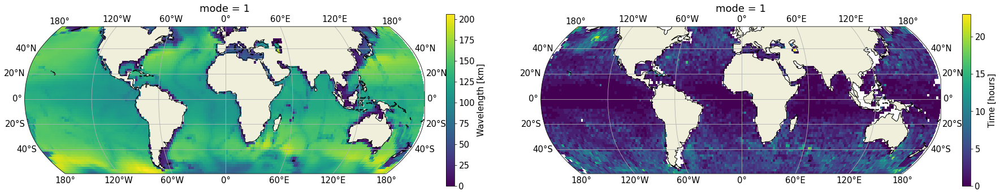

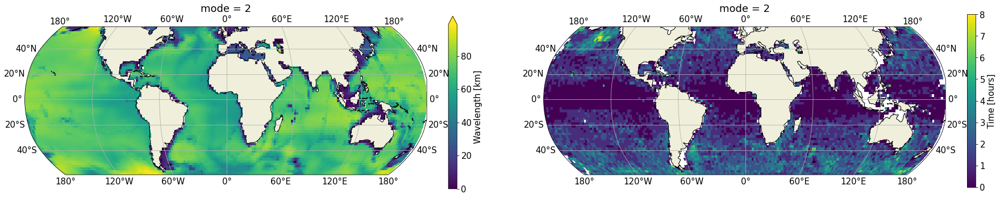

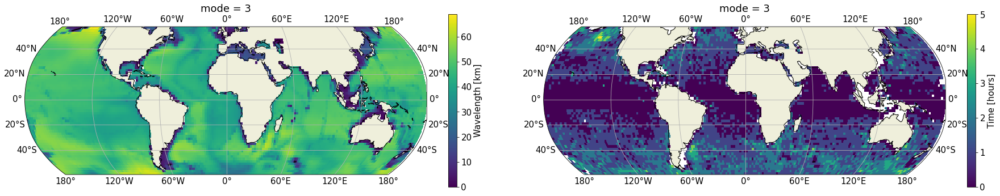

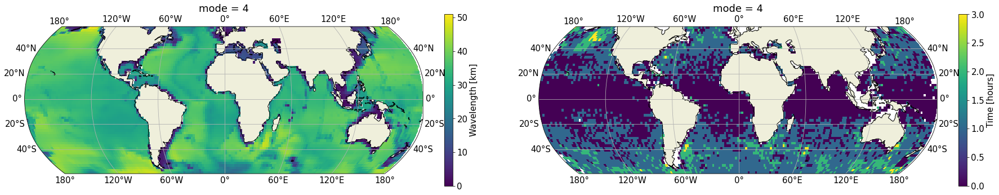

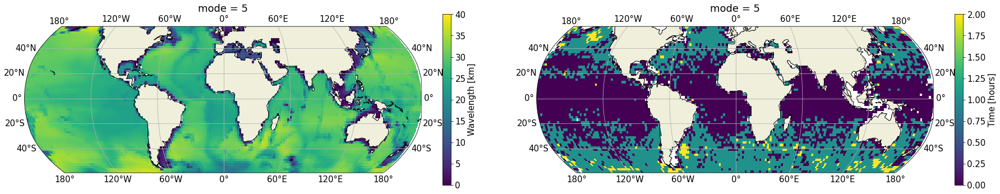

In [47]:
for mode in range(1,6):
    _ds = (rad/_k*1e-3).sel(mode=mode)#.sel(lat_bins=slice(-60,60))
    fig=plt.figure(figsize=(30,8))
    plot_maps(_ds,lat='lat_bins',vlim=(0,np.around(_ds.max().values)),
              colmap='viridis',axes=121,**{'label' : 'Wavelength [km]'})
    plot_maps(ds_out.Tapp.sel(mode=mode)*24,lat='lat_bins',vlim=(0,(ds_out.Tapp.sel(mode=mode)*24).max().values),
              colmap='viridis',axes=122,**{'label' : 'Time [hours]'})
#ds.Tapp.sel(mode=1).plot()


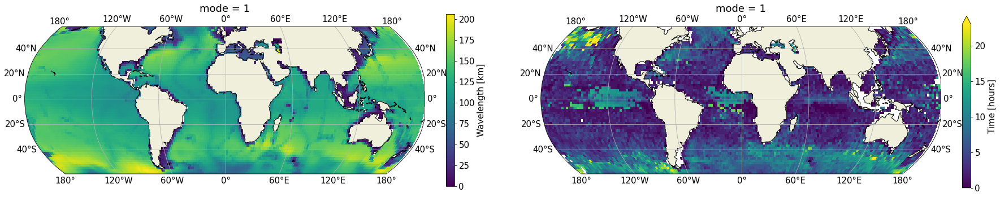

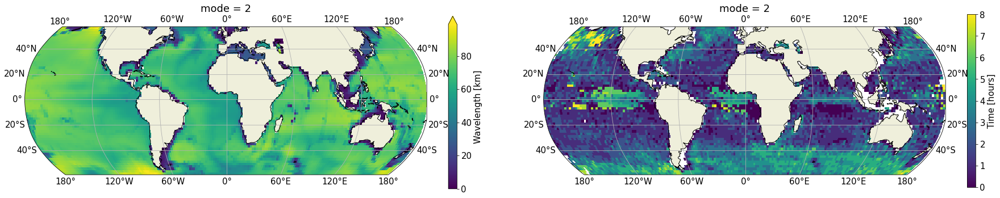

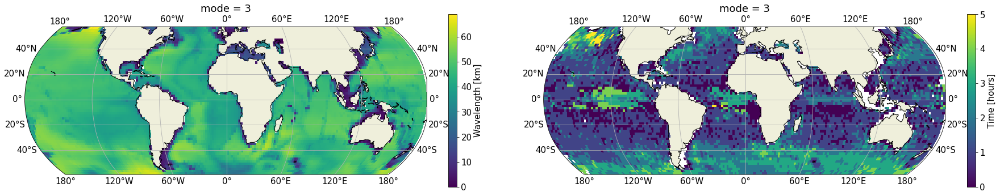

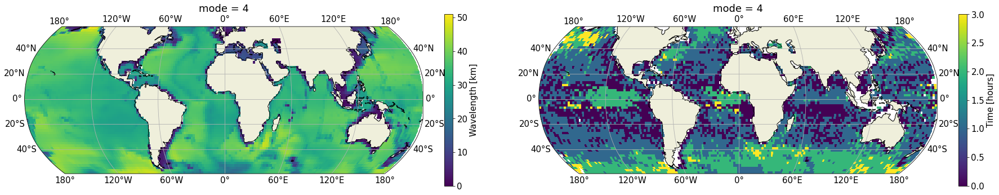

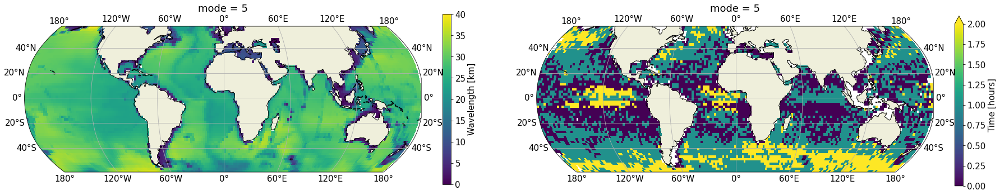

In [48]:
for mode in range(1,6):
    _ds = (rad/_k*1e-3).sel(mode=mode).sel(lat_bins=slice(-60,60))
    fig=plt.figure(figsize=(30,8))
    plot_maps(_ds,lat='lat_bins',vlim=(0,np.around(_ds.max().values)),
              colmap='viridis',axes=121,**{'label' : 'Wavelength [km]'})
    plot_maps(dsV_out.Tapp.sel(mode=mode)*24,lat='lat_bins',vlim=(0,(ds_out.Tapp.sel(mode=mode)*24).max().values),
              colmap='viridis',axes=122,**{'label' : 'Time [hours]'})
#ds.Tapp.sel(mode=1).plot()

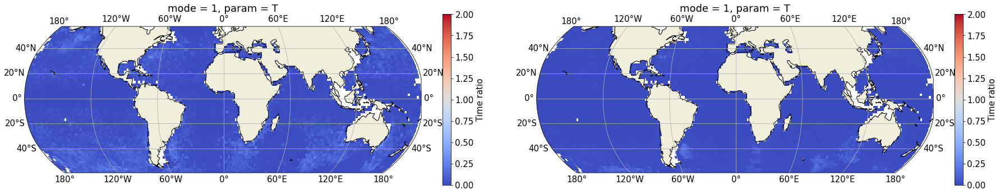

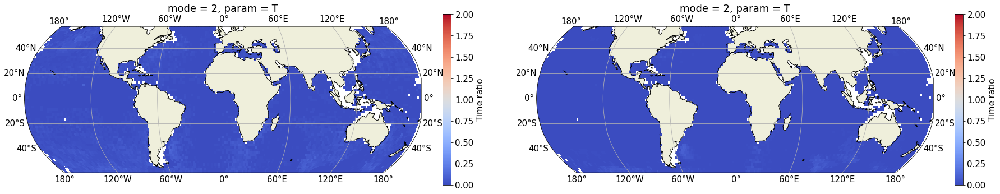

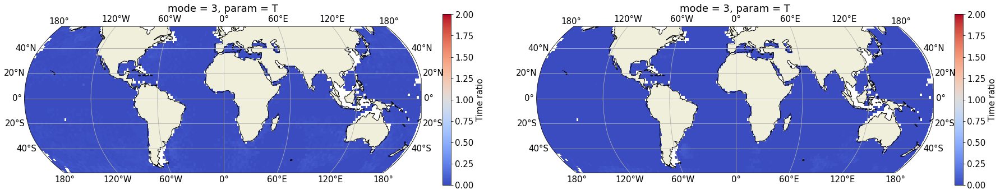

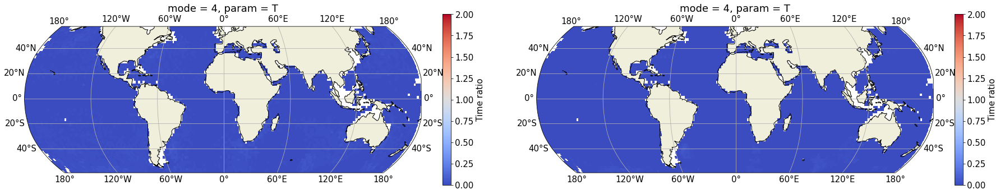

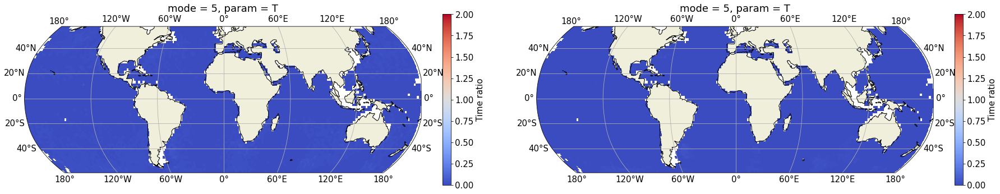

In [68]:
for mode in range(1,6):
    fig=plt.figure(figsize=(30,8))
    plot_maps(ds_out.Tapp.sel(mode=mode)/dsL.sel(param='T').parameters_SSU,lat='lat_bins',vlim=(0,2),
              colmap='coolwarm',axes=121,**{'label' : 'Time ratio'})
    plot_maps(ds_out.Tapp.sel(mode=mode)/dsE.sel(param='T').parameters_SSU,lat='lat_bins',vlim=(0,2),
              colmap='coolwarm',axes=122,**{'label' : 'Time ratio'})

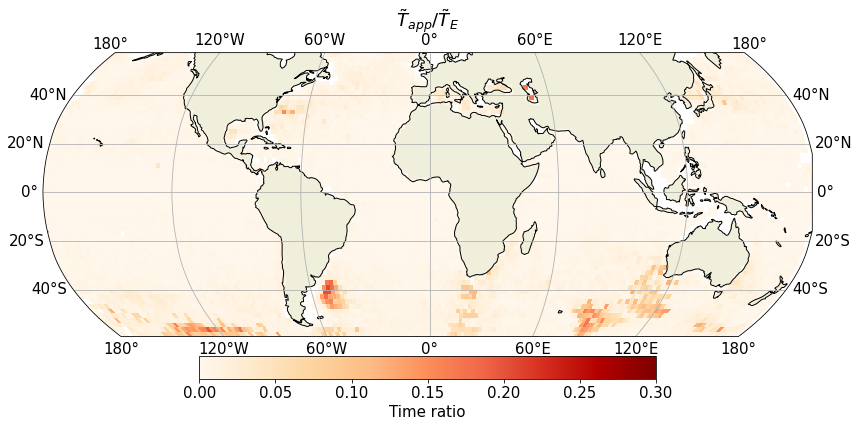

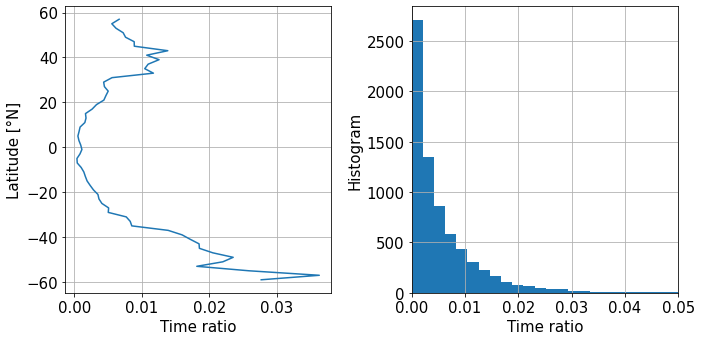

In [53]:
#Ratio of apparent timescale over Eulerian timescale
fig = plt.figure(figsize=(15,6))
fig,ax = plot_maps(ds_out.Tapp.sel(mode=1)/dsE.sel(param='T').parameters_SSU,colmap='OrRd',vlim=(0,0.3),lat='lat_bins',
                   **{'orientation':'horizontal','fraction':0.07,'pad':0.06,'label':'Time ratio'})
ax.set_title(r'$\tilde T_{app} / \tilde T_E$')
#fig.savefig(fig_dir+'TappTe.png')

#Zonal average and histogram of the ratio of apparent timescale over Eulerian timescale
fig,axs = plt.subplots(1,2,figsize=(10,5))
(ds_out.Tapp.sel(mode=1)/dsE.sel(param='T').parameters_SSU).mean('lon_bins').plot(ax=axs[0],y='lat_bins');
axs[0].set_ylabel('Latitude [°N]');
(ds_out.Tapp.sel(mode=1)/dsE.sel(param='T').parameters_SSU).plot.hist(ax=axs[1],bins=100,xlim=(0,0.05));
axs[1].set_ylabel('Histogram');
for ax in axs:
    ax.set_xlabel('Time ratio');ax.grid();ax.set_title('')
fig.tight_layout()
fig.savefig(fig_dir+'TappTe.png')

If we consider the Eulerian timescale to be the "true" one, it makes sense to compare apparent timescale to the Eulerian one. The ratio will then indicate whether the incoherence observed in the Lagrangian frame is due to drifters advection or internal tides incoherence.

To summarize the theory:

1) $\tilde T_{app}<\tilde T_E$ => Apparent incoherence dominates

2) $\tilde T_{app}>\tilde T_E$ => Internal tides incoherence dominates





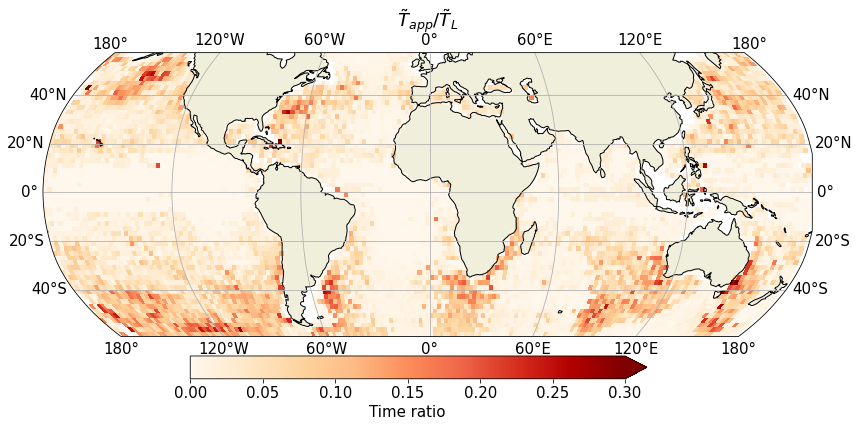

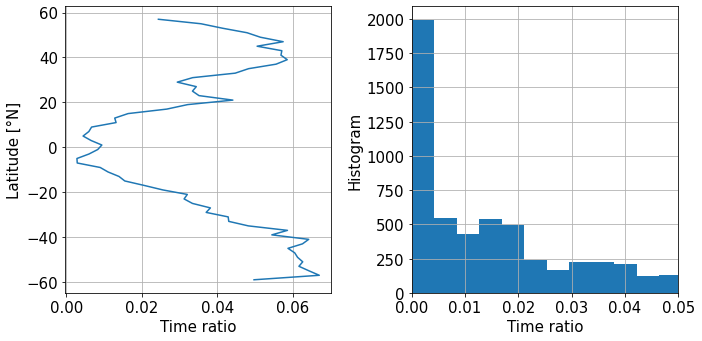

In [54]:
#Ratio of apparent timescale over Eulerian timescale
fig = plt.figure(figsize=(15,6))
fig,ax = plot_maps(ds_out.Tapp.sel(mode=1)/dsL.sel(param='T').parameters_SSU,colmap='OrRd',vlim=(0,0.3),lat='lat_bins',
                   **{'orientation':'horizontal','fraction':0.07,'pad':0.06,'label':'Time ratio'})
ax.set_title(r'$\tilde T_{app} / \tilde T_L$')
#fig.savefig(fig_dir+'TappTe.png')

#Zonal average and histogram of the ratio of apparent timescale over Eulerian timescale
fig,axs = plt.subplots(1,2,figsize=(10,5))
(ds_out.Tapp.sel(mode=1)/dsL.sel(param='T').parameters_SSU).mean('lon_bins').plot(ax=axs[0],y='lat_bins');
axs[0].set_ylabel('Latitude [°N]');
(ds_out.Tapp.sel(mode=1)/dsL.sel(param='T').parameters_SSU).plot.hist(ax=axs[1],bins=100,xlim=(0,0.05));
axs[1].set_ylabel('Histogram');
for ax in axs:
    ax.set_xlabel('Time ratio');ax.grid();ax.set_title('')
fig.tight_layout()
fig.savefig(fig_dir+'TappTl.png')

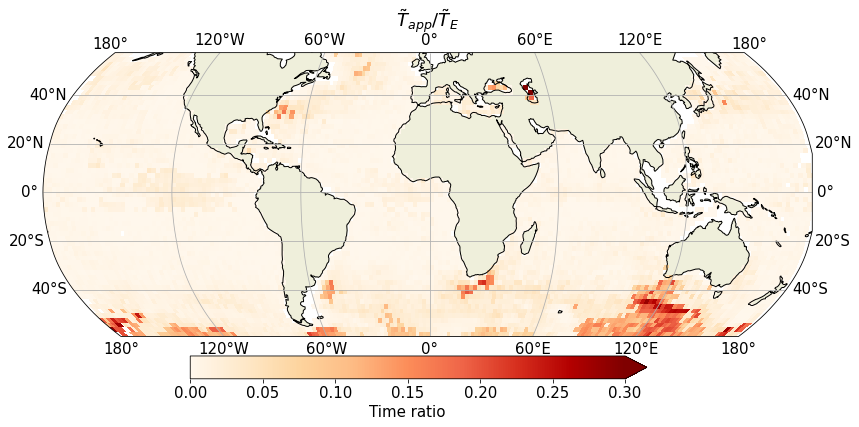

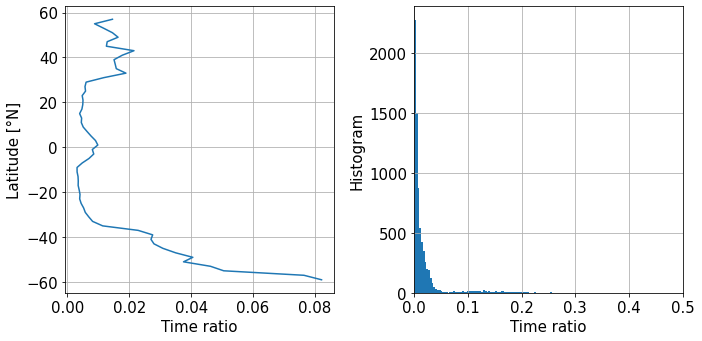

In [55]:
#Ratio of apparent timescale over Eulerian timescale
fig = plt.figure(figsize=(15,6))
fig,ax = plot_maps(dsV_out.Tapp.sel(mode=1)/dsE.sel(param='T').parameters_SSV,colmap='OrRd',vlim=(0,0.3),lat='lat_bins',
                   **{'orientation':'horizontal','fraction':0.07,'pad':0.06,'label':'Time ratio'})
ax.set_title(r'$\tilde T_{app} / \tilde T_E$')
#fig.savefig(fig_dir+'TappTe.png')

#Zonal average and histogram of the ratio of apparent timescale over Eulerian timescale
fig,axs = plt.subplots(1,2,figsize=(10,5))
(dsV_out.Tapp.sel(mode=1)/dsE.sel(param='T').parameters_SSV).mean('lon_bins').plot(ax=axs[0],y='lat_bins');
axs[0].set_ylabel('Latitude [°N]');
(dsV_out.Tapp.sel(mode=1)/dsE.sel(param='T').parameters_SSV).plot.hist(ax=axs[1],bins=100,xlim=(0,0.5));
axs[1].set_ylabel('Histogram');
for ax in axs:
    ax.set_xlabel('Time ratio');ax.grid();ax.set_title('')
fig.tight_layout()

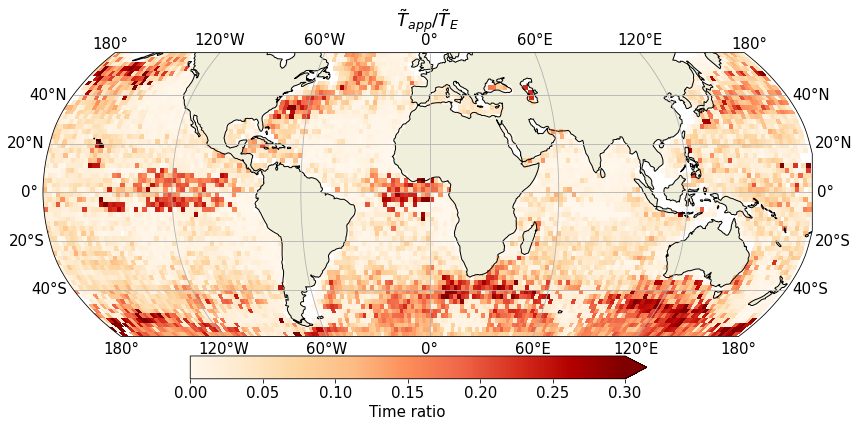

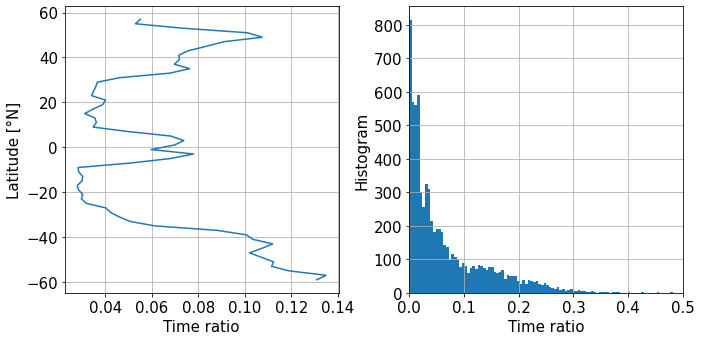

In [56]:
#Ratio of apparent timescale over Eulerian timescale
fig = plt.figure(figsize=(15,6))
fig,ax = plot_maps(dsV_out.Tapp.sel(mode=1)/dsL.sel(param='T').parameters_SSV,colmap='OrRd',vlim=(0,0.3),lat='lat_bins',
                   **{'orientation':'horizontal','fraction':0.07,'pad':0.06,'label':'Time ratio'})
ax.set_title(r'$\tilde T_{app} / \tilde T_E$')
#fig.savefig(fig_dir+'TappTe.png')

#Zonal average and histogram of the ratio of apparent timescale over Eulerian timescale
fig,axs = plt.subplots(1,2,figsize=(10,5))
(dsV_out.Tapp.sel(mode=1)/dsL.sel(param='T').parameters_SSV).mean('lon_bins').plot(ax=axs[0],y='lat_bins');
axs[0].set_ylabel('Latitude [°N]');
(dsV_out.Tapp.sel(mode=1)/dsL.sel(param='T').parameters_SSV).plot.hist(ax=axs[1],bins=100,xlim=(0,0.5));
axs[1].set_ylabel('Histogram');
for ax in axs:
    ax.set_xlabel('Time ratio');ax.grid();ax.set_title('')
fig.tight_layout()

### Effective timescale

Here the goal is to provide a theoretcial estimation of the Lagrangian timescale.

To do so, we want to find:

$\tau \vert \tilde C_E(\tau)e^{-k^2\sigma^2(\tau)/2} = \tilde V_L /2 $

To do so we find $\tau$ minimizing $\tilde C_E(\tau)e^{-k^2\sigma^2(\tau)/2} - \tilde V_L /2$

In [57]:
# Theoretical Lagrangian autocovariance function
Cl = lambda tau,Vt,Tt,Ub,Tb,k: Vt*np.exp(-(tau/Tt)**2)*np.exp(-(k*sigma(tau,Ub,Tb))**2/2)

# Theoretical Eulerian autocovariance function
Ce = lambda tau,Vt,Tt,Ub,Tb,k: Vt*np.exp(-(tau/Tt)**2)*np.exp((k*sigma(tau,Ub,Tb))**2/2)

In [58]:
Tt = dsE.sel(param='T').parameters_SSU  #Eulerian incoherence timescale
Vt = dsE.sel(param='U').parameters_SSU  #Eulerian energy
#Vt = ds_hf_dl2.E_energy_SSU  #Eulerian energy
Tt_L = dsL.sel(param='T').parameters_SSU  #Lagrangian incoherence timescale
Vt_L = dsL.sel(param='U').parameters_SSU   #Lagrangian incoherence timescale
#Vt_L = ds_hf_dl2.L_energy_SSU

#Dataset with parameters for Cl
ds_Teff = xr.Dataset({"tau":(["tau"],tau),                                 # Timelag
                      "lon_bins":(["lon_bins"],ds_low.lon_bin.values),               # longitude
                      "lat_bins":(["lat_bins"],ds_low.lat_bin.values),               # latitude
                      'Tt':(["lon_bins","lat_bins"],Tt.values),                      # Eulerian timescale
                      'Vt':(["lon_bins","lat_bins"],Vt.values),                      # Eulerian energy
                      'TtL':(["lon_bins","lat_bins"],Tt_L.values.T),                      # Lagrangian timescale
                      'VtL':(["lon_bins","lat_bins"],Vt_L.values.T),                 # Lagrangian energy
                      'Tb':(["lon_bins","lat_bins"],Tb.T.values),                    # Low frequency timescale
                      'Ub':(["lon_bins","lat_bins"],Ub.values),                      # Low frequency energy
#                      'k':(['lon','lat'],np.full_like(Vt,2*np.pi/100000))  # Wavenumber
                     })

In [59]:
Tt = dsE.sel(param='T').parameters_SSV  #Eulerian incoherence timescale
Vt = dsE.sel(param='U').parameters_SSV  #Eulerian energy
#Vt = ds_hf_dl2.E_energy_SSU  #Eulerian energy
Tt_L = dsL.sel(param='T').parameters_SSV  #Lagrangian incoherence timescale
Vt_L = dsL.sel(param='U').parameters_SSV   #Lagrangian incoherence timescale
#Vt_L = ds_hf_dl2.L_energy_SSU

#Dataset with parameters for Cl
dsV_Teff = xr.Dataset({"tau":(["tau"],tau),                                 # Timelag
                      "lon_bins":(["lon_bins"],ds_low.lon_bin.values),               # longitude
                      "lat_bins":(["lat_bins"],ds_low.lat_bin.values),               # latitude
                      'Tt':(["lon_bins","lat_bins"],Tt.values),                      # Eulerian timescale
                      'Vt':(["lon_bins","lat_bins"],Vt.values),                      # Eulerian energy
                      'TtL':(["lon_bins","lat_bins"],Tt_L.values.T),                      # Lagrangian timescale
                      'VtL':(["lon_bins","lat_bins"],Vt_L.values.T),                 # Lagrangian energy
                      'Tb':(["lon_bins","lat_bins"],Tb.T.values),                    # Low frequency timescale
                      'Ub':(["lon_bins","lat_bins"],Vb.values),                      # Low frequency energy
#                      'k':(['lon','lat'],np.full_like(Vt,2*np.pi/100000))  # Wavenumber
                     })

In [60]:
ds_Teff['k'] =  _k.sel(mode=slice(1,6))
dsV_Teff['k'] = _k.sel(mode=slice(1,6))

In [61]:
# Lagrangian theoretical autocovariance with estimated parameters
CL = Cl(ds_Teff.tau,ds_Teff.Vt,ds_Teff.Tt,ds_Teff.Ub,ds_Teff.Tb,ds_Teff.k)
CLV = Cl(dsV_Teff.tau,dsV_Teff.Vt,dsV_Teff.Tt,dsV_Teff.Ub,dsV_Teff.Tb,dsV_Teff.k)

In [62]:
ds_Teff['Teff'] = Teff = CL.isel(tau=np.abs(CL-ds_Teff.VtL/2).fillna(-1).argmin('tau')).tau # definition of effective timescale
ds_Teff['Teff'] = ds_Teff['Teff'].where(CL.isel(tau=0)>0)

In [63]:
dsV_Teff['Teff'] = CLV.isel(tau=np.abs(CLV-dsV_Teff.VtL/2).fillna(-1).argmin('tau')).tau # definition of effective timescale
dsV_Teff['Teff'] = dsV_Teff['Teff'].where(CLV.isel(tau=0)>0)

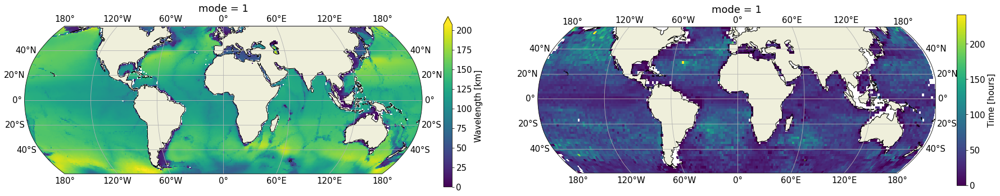

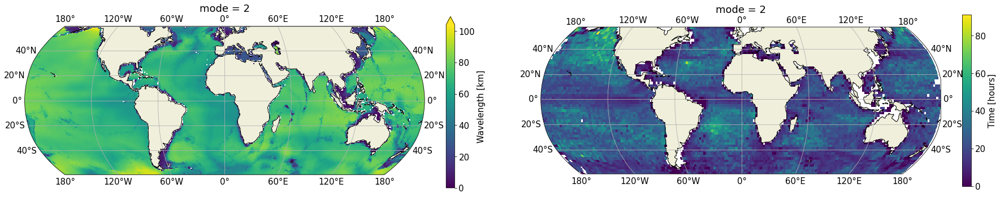

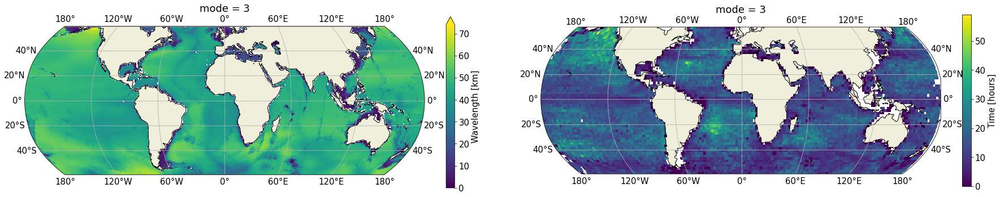

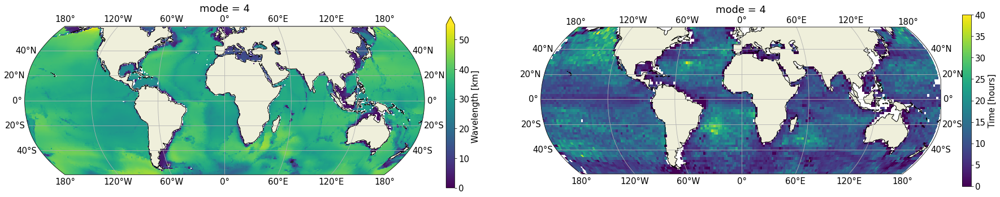

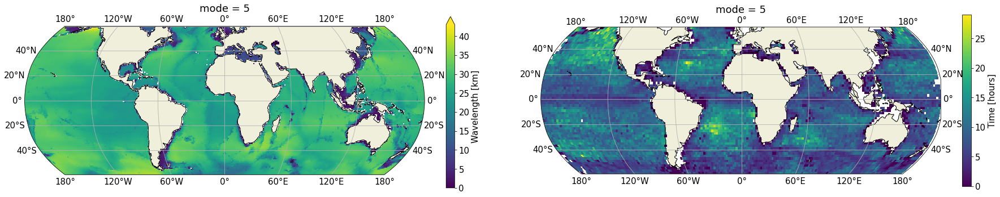

In [64]:
for mode in range(1,6):
    _ds = L.sel(mode=mode).sel(lat_bins=slice(-60,60))
    fig=plt.figure(figsize=(30,8))
    plot_maps(_ds,lat='lat_bins',vlim=(0,np.around(_ds.max().values)),
              colmap='viridis',axes=121,**{'label' : 'Wavelength [km]'})
    plot_maps(ds_Teff.Teff.sel(mode=mode)*24,lat='lat_bins',vlim=(0,(ds_Teff.Teff.sel(mode=mode)*24).max().values),
              colmap='viridis',axes=122,**{'label' : 'Time [hours]'})
#ds.Tapp.sel(mode=1).plot()

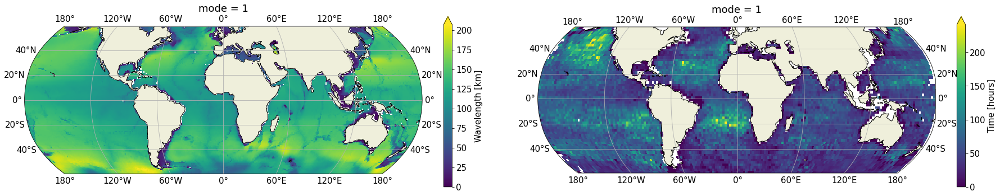

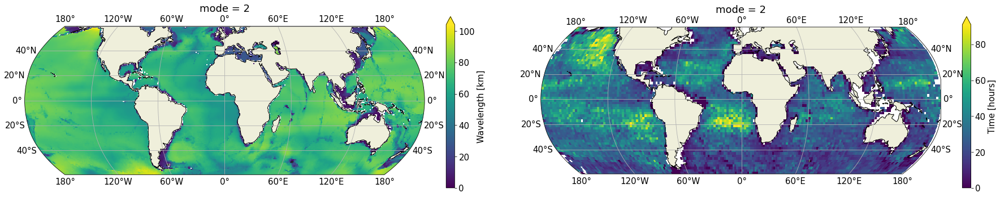

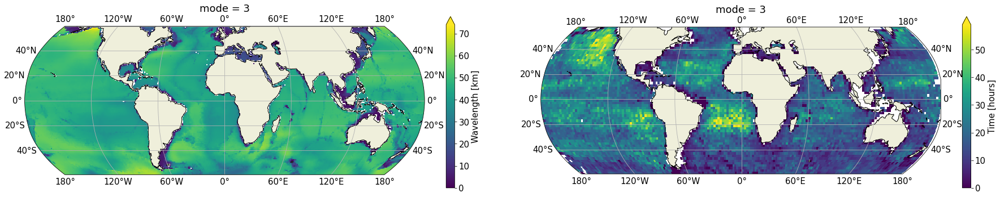

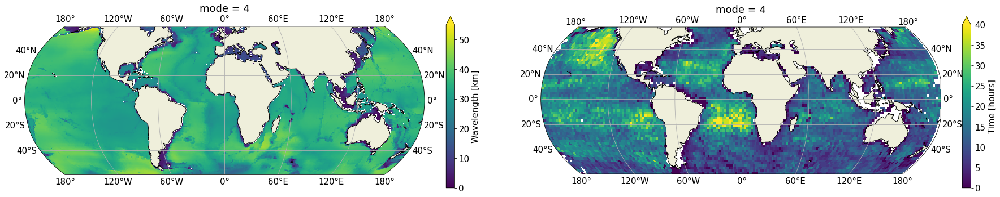

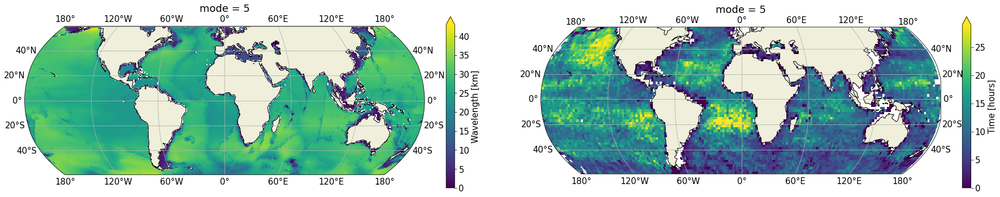

In [65]:
for mode in range(1,6):
    _ds = L.sel(mode=mode).sel(lat_bins=slice(-60,60))
    fig=plt.figure(figsize=(30,8))
    plot_maps(_ds,lat='lat_bins',vlim=(0,np.around(_ds.max().values)),
              colmap='viridis',axes=121,**{'label' : 'Wavelength [km]'})
    plot_maps(dsV_Teff.Teff.sel(mode=mode)*24,lat='lat_bins',vlim=(0,(ds_Teff.Teff.sel(mode=mode)*24).max().values),
              colmap='viridis',axes=122,**{'label' : 'Time [hours]'})
#ds.Tapp.sel(mode=1).plot()

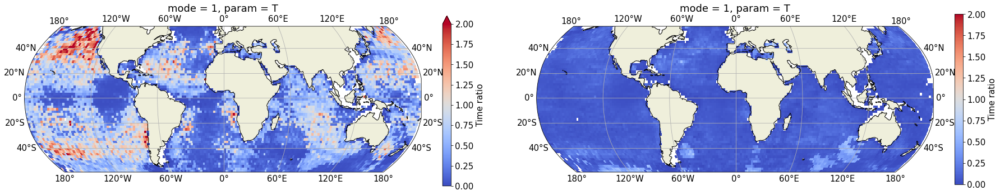

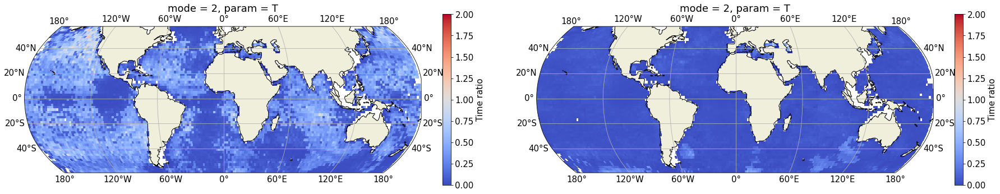

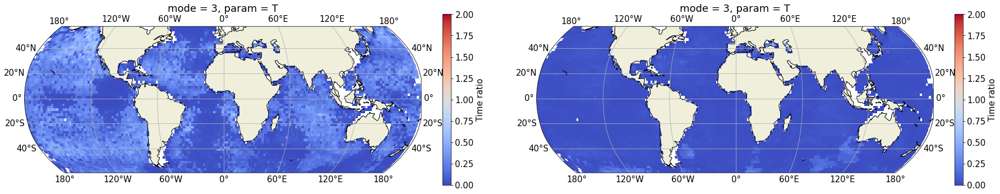

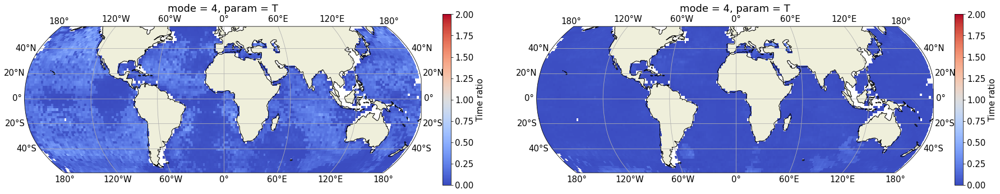

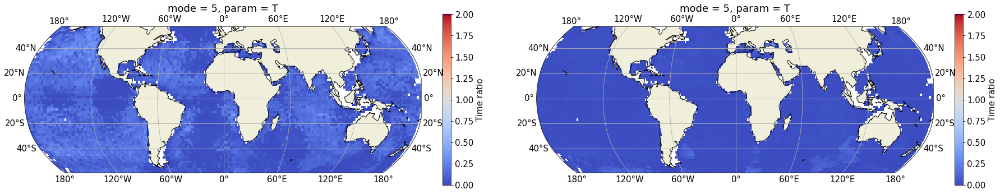

In [66]:
for mode in range(1,6):
    fig=plt.figure(figsize=(30,8))
    plot_maps(ds_Teff.Teff.sel(mode=mode)/dsL.sel(param='T').parameters_SSU,lat='lat_bins',vlim=(0,2),
              colmap='coolwarm',axes=121,**{'label' : 'Time ratio'})
    plot_maps(ds_Teff.Teff.sel(mode=mode)/dsE.sel(param='T').parameters_SSU,lat='lat_bins',vlim=(0,2),
              colmap='coolwarm',axes=122,**{'label' : 'Time ratio'})

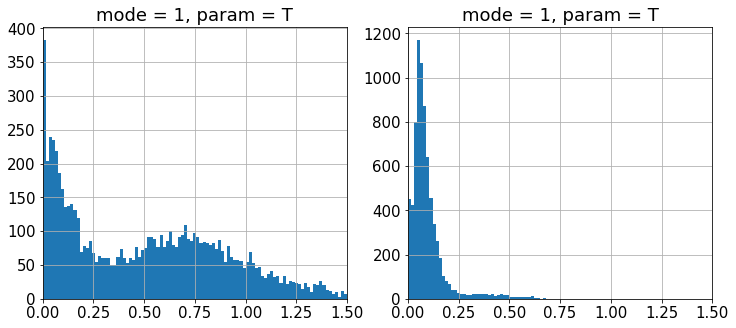

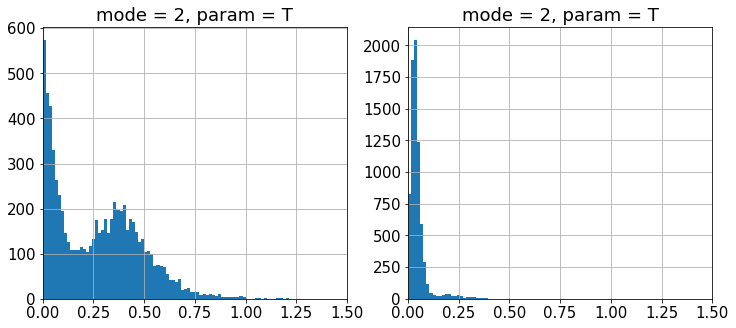

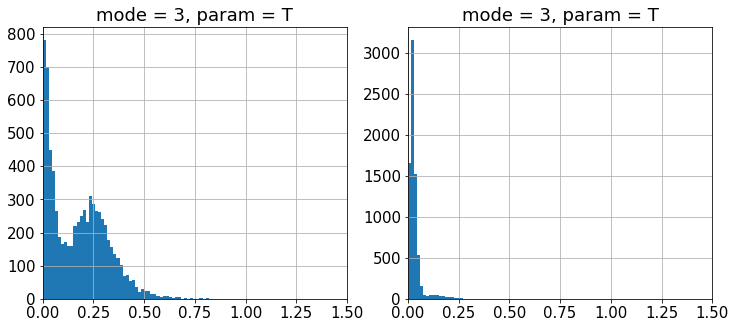

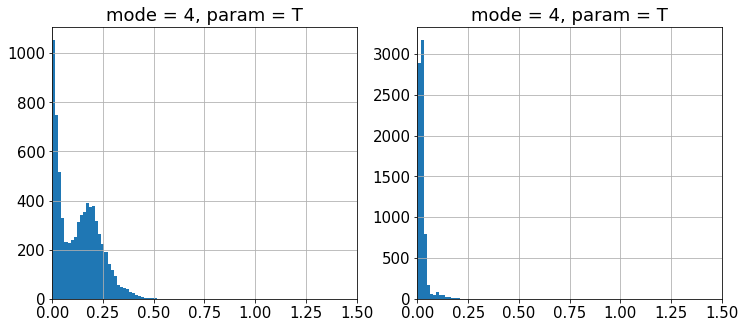

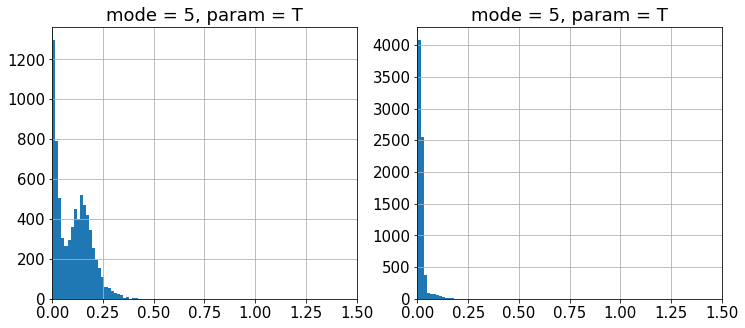

In [69]:
for mode in range(1,6):
    fig,axs=plt.subplots(1,2,figsize=(12,5))
    (ds_Teff.Teff.sel(mode=mode)/dsL.sel(param='T').parameters_SSU).plot.hist(ax=axs[0],bins=np.linspace(0,1.5,100))
    (ds_Teff.Teff.sel(mode=mode)/dsE.sel(param='T').parameters_SSU).plot.hist(ax=axs[1],bins=np.linspace(0,1.5,100))
    for ax in axs:
        ax.grid();ax.set_xlim(0,1.5)

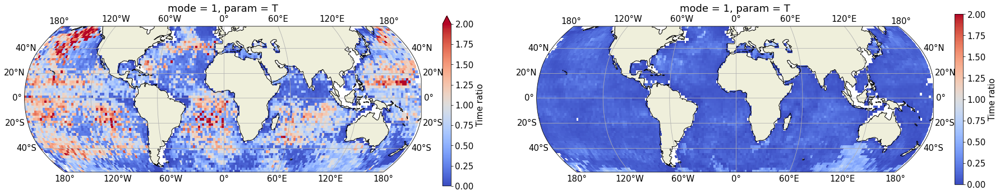

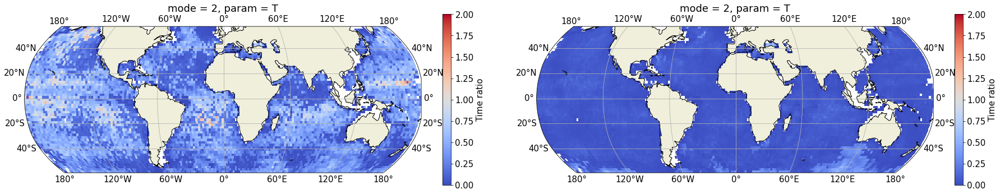

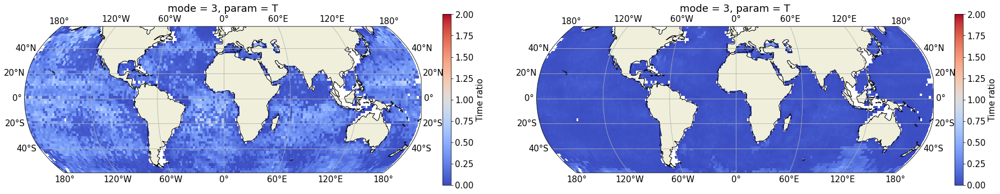

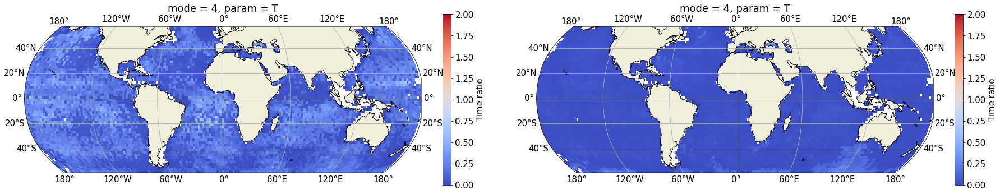

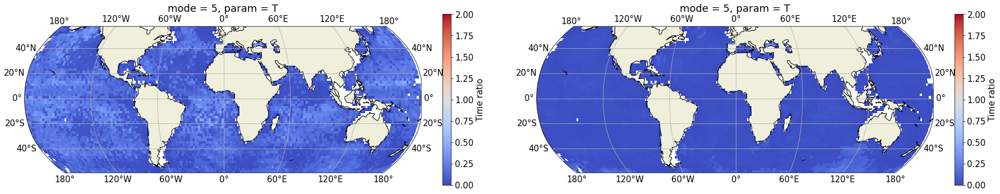

In [70]:
for mode in range(1,6):
    fig=plt.figure(figsize=(30,8))
    plot_maps(dsV_Teff.Teff.sel(mode=mode)/dsL.sel(param='T').parameters_SSV,lat='lat_bins',vlim=(0,2),
              colmap='coolwarm',axes=121,**{'label' : 'Time ratio'})
    plot_maps(dsV_Teff.Teff.sel(mode=mode)/dsE.sel(param='T').parameters_SSV,lat='lat_bins',vlim=(0,2),
              colmap='coolwarm',axes=122,**{'label' : 'Time ratio'})

In [71]:
ds_Teff['kTeff'] = ds_out.ksigma.sel(tau=Teff,method='nearest')
dsV_Teff['kTeff'] = dsV_out.ksigma.sel(tau=Teff,method='nearest')

/opt/anaconda3/envs/croco/lib/python3.8/site-packages/xarray/core/computation.py:727: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)
/opt/anaconda3/envs/croco/lib/python3.8/site-packages/xarray/core/computation.py:727: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)
/opt/anaconda3/envs/croco/lib/python3.8/site-packages/xarray/core/computation.py:727: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)
/opt/anaconda3/envs/croco/lib/python3.8/site-packages/xarray/core/computation.py:727: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)
/opt/anaconda3/envs/croco/lib/python3.8/site-packages/xarray/core/computation.py:727: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)
/opt/anaconda3/envs/croco/lib/python3.8/site-packages/xarray/core/computation.py:727: RuntimeWarning: divide by zero encountered in log10
  

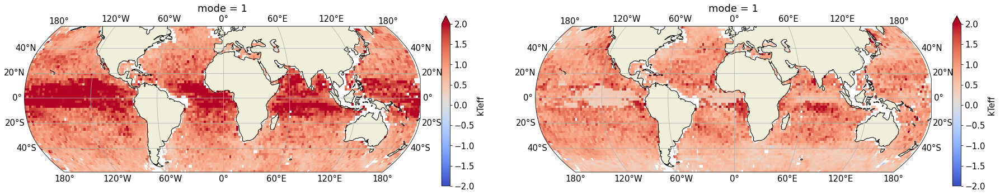

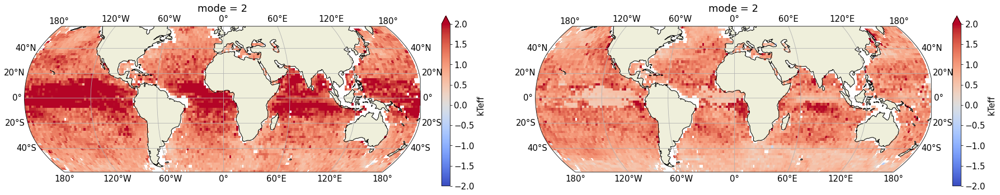

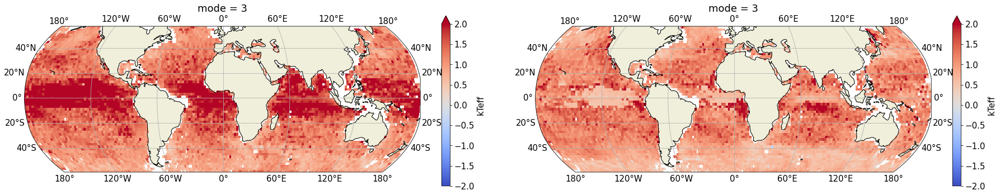

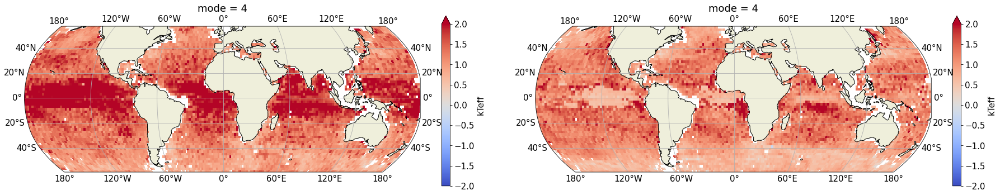

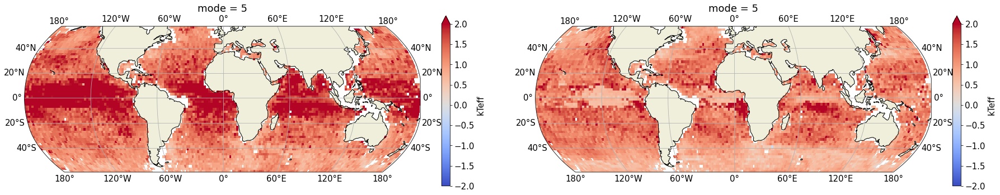

In [72]:
for mode in range(1,6):
    fig = plt.figure(figsize=(30,8))
    plot_maps(np.log10(ds_Teff.kTeff.sel(mode=mode)),lat='lat_bins',colmap='coolwarm',vlim=(-2,2),axes=121)
    plot_maps(np.log10(dsV_Teff.kTeff.sel(mode=mode)),lat='lat_bins',colmap='coolwarm',vlim=(-2,2),axes=122)

#### $k\sigma(\tau) = \sqrt{2ln(2\tilde V_E/\tilde V_L)}$

In [76]:
#Eulerian and Lagrangian energy
hf_dl2 = xr.merge([xr.open_dataset(root_dir+'energy_SSU_hf_binned_dl2.0.nc'),
                   xr.open_dataset(root_dir+'energy_SSV_hf_binned_dl2.0.nc')
                  ]).rename({'lon_bin':'lon_bins','lat_bin':'lat_bins'})

In [77]:
Ue = hf_dl2.E_energy_SSU#.fillna(-1)
Ul = hf_dl2.L_energy_SSU#.fillna(-1)

Ve = hf_dl2.E_energy_SSV#.fillna(-1)
Vl = hf_dl2.L_energy_SSV#.fillna(-1)


In [78]:

ds_out_bis = ksigma_minimizing(ds,minim=np.sqrt(2*np.log(2*Ue/Ul)).fillna(-1))
dsV_out_bis = ksigma_minimizing(dsV,minim=np.sqrt(2*np.log(2*Ve/Vl)).fillna(-1))

/opt/anaconda3/envs/croco/lib/python3.8/site-packages/xarray/core/computation.py:727: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/opt/anaconda3/envs/croco/lib/python3.8/site-packages/xarray/core/computation.py:727: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)


In [79]:
ds_out_bis

<xarray.Dataset>
Dimensions:   (lon_bins: 179, lat_bins: 59, tau: 720, mode: 5)
Coordinates:
  * lon_bins  (lon_bins) float64 -179.0 -177.0 -175.0 ... 173.0 175.0 177.0
  * lat_bins  (lat_bins) float64 -59.0 -57.0 -55.0 -53.0 ... 51.0 53.0 55.0 57.0
  * tau       (tau) float64 0.0 0.04167 0.08333 0.125 ... 29.88 29.92 29.96
  * mode      (mode) int64 1 2 3 4 5
Data variables:
    Tb        (lon_bins, lat_bins) float64 nan 1.282 4.14 ... 1.419 1.64 1.515
    Ub        (lon_bins, lat_bins) float64 0.1195 0.2037 ... 0.1299 0.1297
    k         (lat_bins, lon_bins, mode) float32 3.639e-05 ... 0.0001846
    ksigma    (lat_bins, lon_bins, mode, tau) float64 nan nan ... 67.14 67.19
    _ksigma   (lat_bins, lon_bins, mode, tau) float64 -10.0 -10.0 ... 67.19
    Minimize  (lat_bins, lon_bins, mode) int64 0 0 0 0 0 7 3 2 ... 2 1 9 4 2 2 1
    Tapp      (lat_bins, lon_bins, mode) float64 nan nan nan ... 0.08333 0.04167

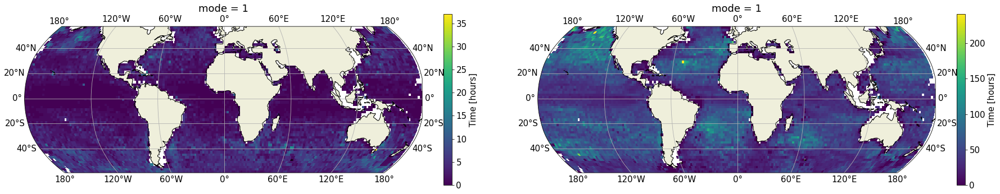

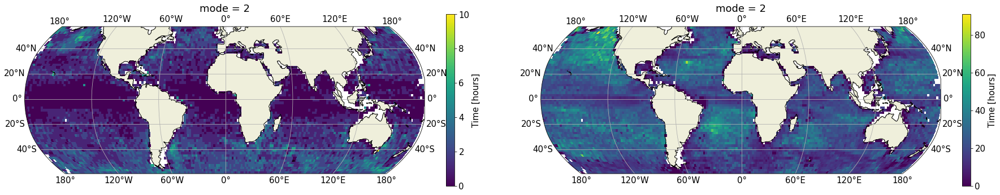

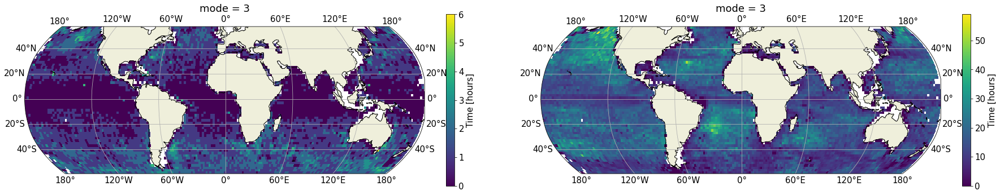

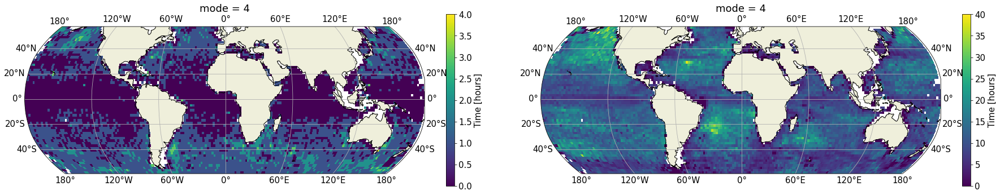

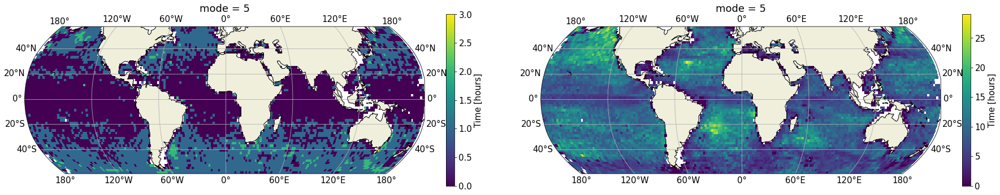

In [84]:
for mode in range(1,6):
    fig=plt.figure(figsize=(30,8))
    plot_maps(ds_out_bis.Tapp.sel(mode=mode)*24,lat='lat_bins',vlim=(0,None),
              colmap='viridis',axes=121,**{'label' : 'Time [hours]'})
    plot_maps(ds_Teff.Teff.sel(mode=mode)*24,lat='lat_bins',vlim=(0,None),
              colmap='viridis',axes=122,**{'label' : 'Time [hours]'})

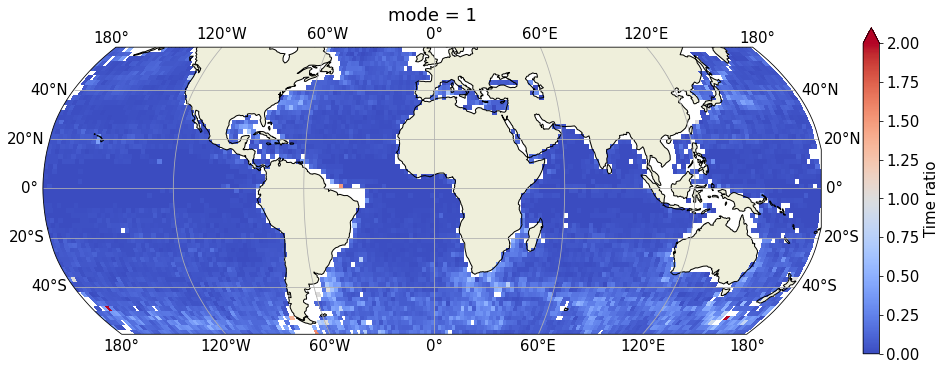

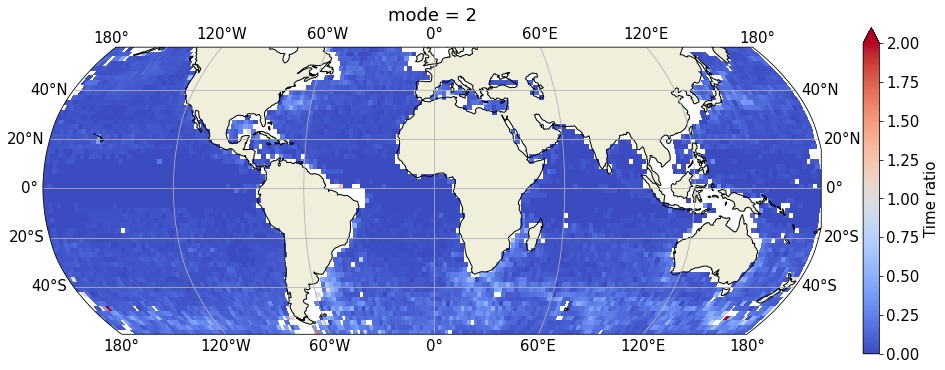

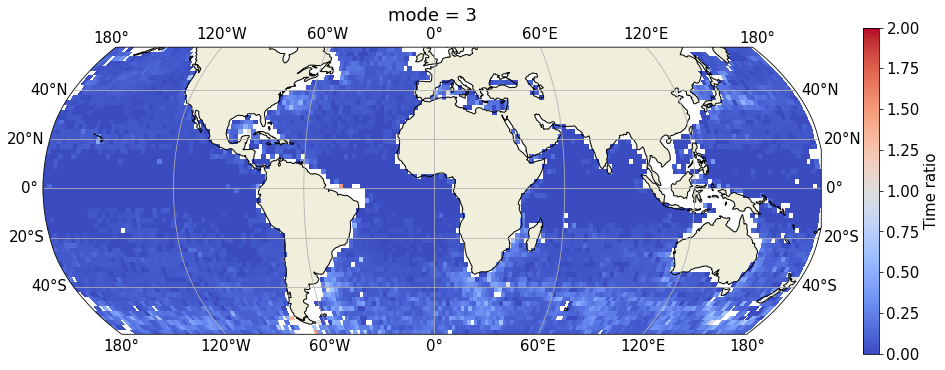

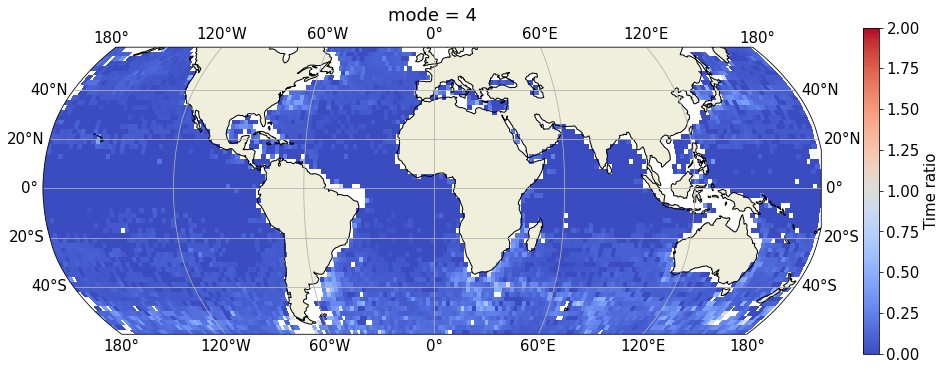

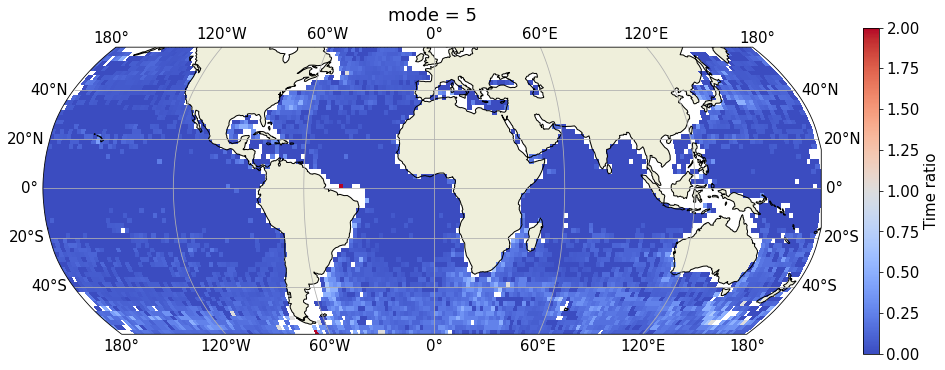

In [92]:
for mode in range(1,6):
    fig=plt.figure(figsize=(15,6))
    plot_maps((ds_out_bis.Tapp/ds_Teff.Teff).sel(mode=mode),lat='lat_bins',vlim=(0,2),
              colmap='coolwarm',axes=111,**{'label' : 'Time ratio'})

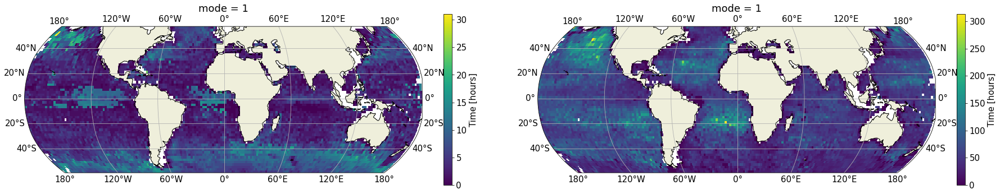

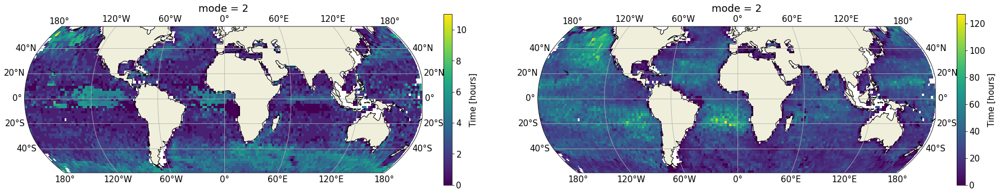

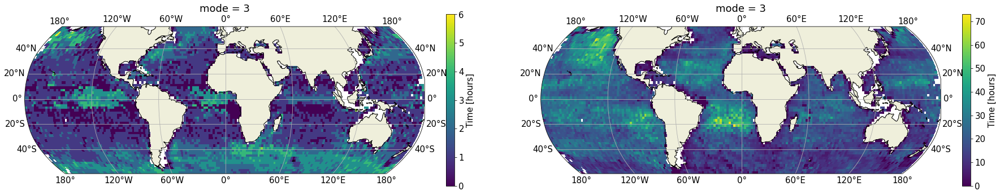

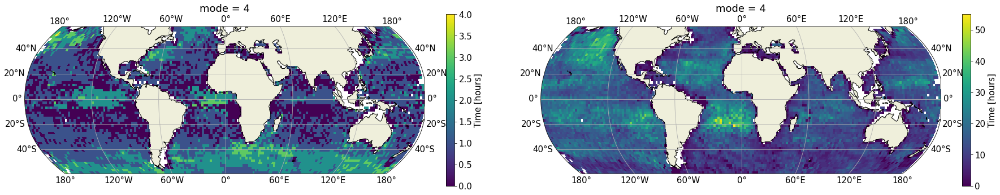

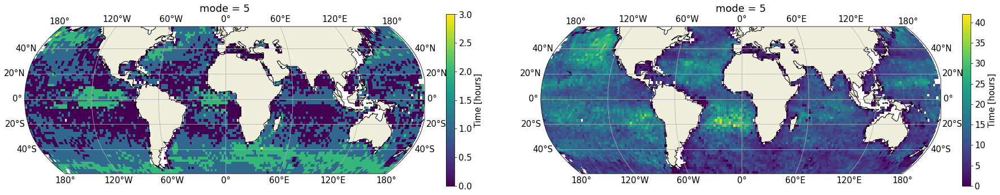

In [85]:
for mode in range(1,6):
    fig=plt.figure(figsize=(30,8))
    plot_maps(dsV_out_bis.Tapp.sel(mode=mode)*24,lat='lat_bins',vlim=(0,None),
              colmap='viridis',axes=121,**{'label' : 'Time [hours]'})
    plot_maps(dsV_Teff.Teff.sel(mode=mode)*24,lat='lat_bins',vlim=(0,None),
              colmap='viridis',axes=122,**{'label' : 'Time [hours]'})

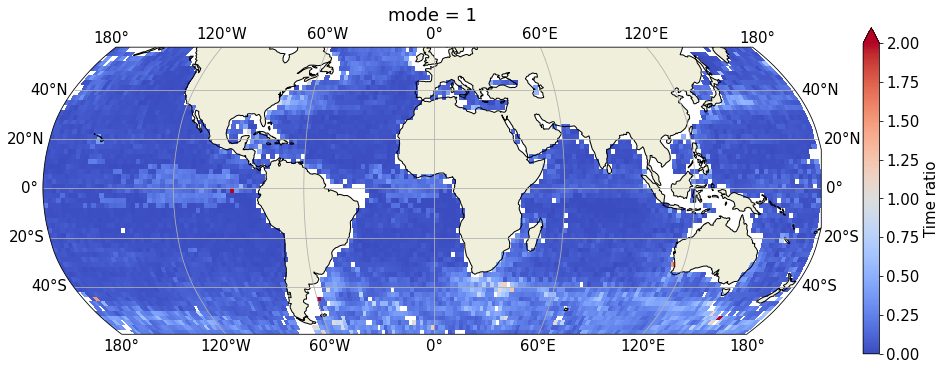

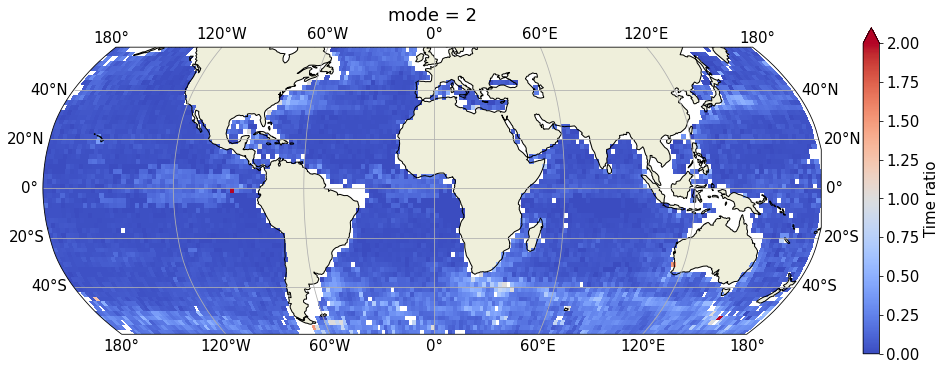

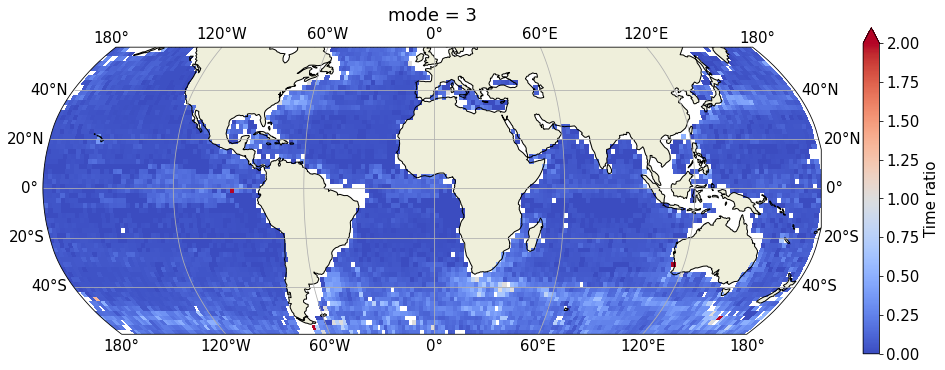

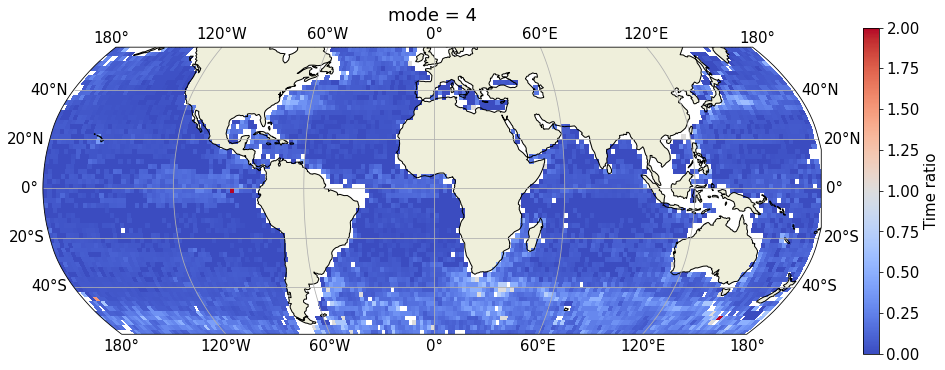

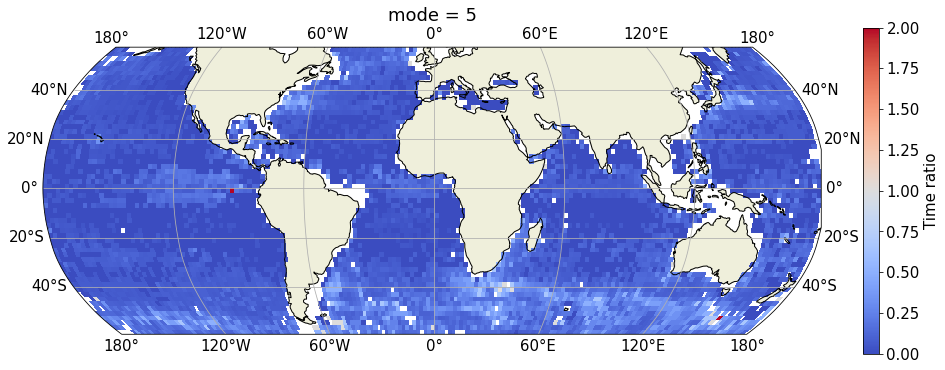

In [114]:
for mode in range(1,6):
    fig=plt.figure(figsize=(15,6))
    plot_maps((dsV_out_bis.Tapp/dsV_Teff.Teff).sel(mode=mode),lat='lat_bins',vlim=(0,2),
              colmap='coolwarm',axes=111,**{'label' : 'Time ratio'})